# DM PROJECT GROUP
__________________________________________________________________________
 |      |     Student Name     |     Student ID     | 
|---   |         ---          |           ---          |
| 1    |      Diogo Barros        |         20230555     | 
| 2    |      Diogo Roiçado        |      20230557         | 
| 3    |      Duarte Mendes        |        20230494       | 
__________________________________________________________________________

<a id='PVA'></a></b><br>
* [0. Imports](#imp)
* [1. Simple Data Description](#init_desc)
    * [1.1. Initial Data Exploration](#init_exp)
    * [1.2. Data Inconsistencies](#incon)
    * [1.3. Feature Segmentation](#segmentation)
* [2. Data Visualization](#visualization)
    * [2.1. Data Visualization over time](#feat_change)
* [3. Data Preprocessing](#prep)
    * [3.1. Data Partition](#part)
    * [3.2. Feature Engineering](#feat_eng_bi)
    * [3.3. Bivariate Outliers](#bi_outliers)
    * [3.4. Feature Engineering](#feat_eng_oh)
* [4. Feature Selection](#feat_selection)
    * [4.1. Filter Methods](#filter_methods)
    * [4.2. Redundancy vs Relevancy](#red_vs_rel)
* [5. Scaling](#Scale)
* [6. Auxiliary functions](#aux)
* [7. Clustering Algorithms](#Clustering)
* [8. Customer Segmentation](#segm)

<hr>
<a class="anchor" id="imp">

# 0. Imports the needed libraries and data
    
</a>

In [1]:
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn.preprocessing as prep
import math
#import pandas_profiling
from itertools import product
from datetime import datetime
from os.path import join

from sklearn import datasets
from sklearn.impute import KNNImputer
from sklearn.base import clone
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, silhouette_score, silhouette_samples, pairwise_distances
from sklearn.neighbors import KNeighborsClassifier, NearestNeighbors
from sklearn.cluster import AgglomerativeClustering, KMeans, DBSCAN, MeanShift, estimate_bandwidth
from sklearn.manifold import TSNE

from scipy.cluster.hierarchy import dendrogram

import graphviz
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_graphviz

#!pip install scikit-learn-extra
from sklearn_extra.cluster import KMedoids
#!pip install kmodes
from kmodes.kprototypes import KPrototypes

import matplotlib.cm as cm
#from minisom import MiniSom

from collections import Counter
import missingno as msno
import warnings

from matplotlib import __version__ as mplver

In [2]:
import umap
from umap import UMAP

In [3]:
import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView

In [4]:
#!pip install corner
import corner

### Import dataset

In [5]:
data = pd.read_csv("XYZ_sports_dataset.csv",delimiter = ';')

data_original = data.copy()
data.head()

,ID,Age,Gender,Income,EnrollmentStart,EnrollmentFinish,LastPeriodStart,LastPeriodFinish,DateLastVisit,DaysWithoutFrequency,...,OtherActivities,NumberOfFrequencies,AttendedClasses,AllowedWeeklyVisitsBySLA,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,HasReferences,NumberOfReferences,Dropout
0,10000,60,Female,5500.0,2019-09-03,2019-10-31,2019-07-01,2019-12-31,2019-10-30,1,...,0.0,9.0,7,NaN,6.28,2,0,0.0,0,0
1,10001,29,Female,2630.0,2014-08-12,2015-09-14,2015-01-01,2015-12-31,2015-07-16,60,...,0.0,23.0,1,2.0,17.42,1,2,0.0,0,1
2,10002,23,Male,1980.0,2017-05-02,2017-06-01,2017-01-01,2017-06-30,2017-05-25,7,...,0.0,6.0,0,7.0,30.03,6,0,0.0,0,1
3,10003,9,Male,0.0,2018-09-05,2019-02-12,2018-07-01,2019-06-30,2019-01-21,22,...,0.0,20.0,2,2.0,17.72,3,0,0.0,0,1
4,10004,35,Male,4320.0,2016-04-20,2018-06-07,2018-01-01,2018-06-30,2017-11-09,210,...,NaN,41.0,0,7.0,60.97,0,3,0.0,0,1


<hr>
<a class="anchor" id="init_desc">

# 1. Initial Data Description
    
</a>

In [6]:
data = data.set_index('ID')

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14942 entries, 10000 to 24941
Data columns (total 30 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Age                         14942 non-null  int64  
 1   Gender                      14942 non-null  object 
 2   Income                      14447 non-null  float64
 3   EnrollmentStart             14942 non-null  object 
 4   EnrollmentFinish            14942 non-null  object 
 5   LastPeriodStart             14942 non-null  object 
 6   LastPeriodFinish            14942 non-null  object 
 7   DateLastVisit               14942 non-null  object 
 8   DaysWithoutFrequency        14942 non-null  int64  
 9   LifetimeValue               14942 non-null  float64
 10  UseByTime                   14942 non-null  int64  
 11  AthleticsActivities         14906 non-null  float64
 12  WaterActivities             14905 non-null  float64
 13  FitnessActivities           1490

In [8]:
data.describe(include = "all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Age,14942.0,NaN,NaN,NaN,26.015794,14.156582,0.0,19.0,23.0,31.0,87.0
Gender,14942,2,Female,8931,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Income,14447.0,NaN,NaN,NaN,2230.816086,1566.527734,0.0,1470.0,1990.0,2790.0,10890.0
EnrollmentStart,14942,1490,2015-03-02,92,NaN,NaN,NaN,NaN,NaN,NaN,NaN
EnrollmentFinish,14942,1300,2015-09-16,1684,NaN,NaN,NaN,NaN,NaN,NaN,NaN
LastPeriodStart,14942,12,2019-07-01,3172,NaN,NaN,NaN,NaN,NaN,NaN,NaN
LastPeriodFinish,14942,11,2019-12-31,3694,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DateLastVisit,14942,1384,2019-10-31,475,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DaysWithoutFrequency,14942.0,NaN,NaN,NaN,81.224936,144.199576,0.0,13.0,41.0,83.75,1745.0
LifetimeValue,14942.0,NaN,NaN,NaN,302.561871,364.319566,0.0,83.6,166.2,355.075,6727.8


As we can see theres a lot of missing values that are not allowing to check the description of some features.

### Repeated Entries

<hr>
<a class="anchor" id="init_exp">

# 1.1. Initial Data Exploration
    
</a>

In [9]:
data[data.duplicated(keep = False)]

,Age,Gender,Income,EnrollmentStart,EnrollmentFinish,LastPeriodStart,LastPeriodFinish,DateLastVisit,DaysWithoutFrequency,LifetimeValue,...,OtherActivities,NumberOfFrequencies,AttendedClasses,AllowedWeeklyVisitsBySLA,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,HasReferences,NumberOfReferences,Dropout
ID,,,,,,,,,,,,,,,,,,,,,
18942,12,Female,0.0,2019-06-18,2019-09-10,2019-07-01,2019-12-31,2019-07-31,41,73.35,...,0.0,14.0,7,5.0,44.3,10,1,0.0,0,1
22873,12,Female,0.0,2019-06-18,2019-09-10,2019-07-01,2019-12-31,2019-07-31,41,73.35,...,0.0,14.0,7,5.0,44.3,10,1,0.0,0,1


In [10]:
tot_removed = len(data[data.duplicated(keep = 'first')])
print("Total Removed:", tot_removed)
data = data[~data.duplicated(keep="first")]

Total Removed: 1


### Missing Values

In [11]:
data.isna().sum()[data.isna().sum() > 0]

Income                      495
AthleticsActivities          36
WaterActivities              37
FitnessActivities            35
DanceActivities              36
TeamActivities               35
RacketActivities             37
CombatActivities             33
NatureActivities             47
SpecialActivities            44
OtherActivities              35
NumberOfFrequencies          26
AllowedWeeklyVisitsBySLA    535
HasReferences                12
dtype: int64

<hr>
<a class="anchor" id="incon">

# 1.2  Inconsistencies 
    
</a>

1) Clients that had visited more in the LastPeriod then the period of Enrollment

This is not an inconsistency

In [12]:
data[data["NumberOfFrequencies"] < data["RealNumberOfVisits"]].head(2)

,Age,Gender,Income,EnrollmentStart,EnrollmentFinish,LastPeriodStart,LastPeriodFinish,DateLastVisit,DaysWithoutFrequency,LifetimeValue,...,OtherActivities,NumberOfFrequencies,AttendedClasses,AllowedWeeklyVisitsBySLA,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,HasReferences,NumberOfReferences,Dropout
ID,,,,,,,,,,,,,,,,,,,,,
10117,39,Female,3570.0,2015-12-11,2016-02-02,2015-07-01,2016-06-30,2016-01-28,5,110.1,...,0.0,15.0,0,7.0,49.0,16,0,0.0,0,1
10140,3,Male,0.0,2019-09-05,2019-10-31,2019-07-01,2019-12-31,2019-10-26,5,123.8,...,0.0,5.0,5,NaN,16.0,6,0,0.0,0,0


2. The client made more visits to the facilities then the number his contract allowed him to do.

In [13]:
data[data["RealNumberOfVisits"] > data["AllowedNumberOfVisitsBySLA"]].head(2)

,Age,Gender,Income,EnrollmentStart,EnrollmentFinish,LastPeriodStart,LastPeriodFinish,DateLastVisit,DaysWithoutFrequency,LifetimeValue,...,OtherActivities,NumberOfFrequencies,AttendedClasses,AllowedWeeklyVisitsBySLA,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,HasReferences,NumberOfReferences,Dropout
ID,,,,,,,,,,,,,,,,,,,,,
10271,35,Female,1000.0,2015-02-20,2015-02-20,2019-07-01,2019-12-31,2019-10-29,2,1235.85,...,0.0,196.0,191,2.0,6.86,10,5,0.0,0,0
10354,48,Female,4390.0,2016-09-12,2019-10-31,2017-01-01,2017-12-31,2019-10-31,0,441.30,...,0.0,214.0,0,7.0,30.03,34,3,0.0,0,1


3. Income for age < 18, probably it is the income of the responsable person for the child. It is not supposed that a person with age < 18 have an income.

In [14]:
data[(data['Age'] < 18) & (data['Income'] > 0)].head(2)

,Age,Gender,Income,EnrollmentStart,EnrollmentFinish,LastPeriodStart,LastPeriodFinish,DateLastVisit,DaysWithoutFrequency,LifetimeValue,...,OtherActivities,NumberOfFrequencies,AttendedClasses,AllowedWeeklyVisitsBySLA,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,HasReferences,NumberOfReferences,Dropout
ID,,,,,,,,,,,,,,,,,,,,,
10026,17,Male,1290.0,2015-01-02,2016-07-31,2016-01-01,2016-12-31,2016-05-30,62,907.2,...,0.0,64.0,67,2.0,17.42,0,2,0.0,0,1
10058,17,Female,1680.0,2014-09-30,2015-09-16,2015-01-01,2015-12-31,2015-05-27,112,476.1,...,0.0,43.0,0,7.0,60.97,0,1,0.0,0,1


4.

Isto não é uma inconsistência

In [15]:
data[(data['DateLastVisit'] > data['LastPeriodFinish'])].head()

,Age,Gender,Income,EnrollmentStart,EnrollmentFinish,LastPeriodStart,LastPeriodFinish,DateLastVisit,DaysWithoutFrequency,LifetimeValue,...,OtherActivities,NumberOfFrequencies,AttendedClasses,AllowedWeeklyVisitsBySLA,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,HasReferences,NumberOfReferences,Dropout
ID,,,,,,,,,,,,,,,,,,,,,
10023,24,Male,1710.0,2016-10-13,2019-10-31,2018-01-01,2018-12-31,2019-10-25,6,969.90,...,0.0,207.0,207,3.0,26.13,11,3,0.0,0,1
10098,35,Male,6490.0,2015-09-14,2016-07-08,2016-01-01,2016-06-30,2016-07-08,0,216.50,...,0.0,37.0,0,7.0,59.99,4,0,0.0,0,1
10223,51,Male,5640.0,2014-09-10,2014-09-10,2017-01-01,2017-12-31,2019-09-20,41,1198.60,...,0.0,138.0,134,2.0,17.42,3,5,0.0,0,0
10236,19,Female,1190.0,2019-02-28,2019-02-28,2019-01-01,2019-06-30,2019-10-30,1,92.70,...,0.0,25.0,0,7.0,60.97,12,1,0.0,0,0
10279,3,Female,0.0,2018-01-15,2018-01-15,2018-01-01,2018-12-31,2019-10-23,8,587.55,...,0.0,29.0,8,2.0,17.42,1,2,0.0,0,0


5. HasReferences = 0 and NumberOfReferences > 0

In [16]:
data.groupby('HasReferences')["NumberOfReferences"].value_counts()

HasReferences  NumberOfReferences
0.0            0                     14632
1.0            1                       257
               2                        19
               0                        13
               3                         8
Name: count, dtype: int64

This inconsistency can be easily removed by filling every instance that have NumberOfReferences as 0 with HasReferences = 0.

In [17]:
data['HasReferences'] = np.where(data['NumberOfReferences'] == 0, 0, 1).astype(int)
data.groupby('HasReferences')["NumberOfReferences"].value_counts()

HasReferences  NumberOfReferences
0              0                     14645
1              1                       267
               2                        21
               3                         8
Name: count, dtype: int64

<hr>
<a class="anchor" id="Prep">

# 1.2.1 Customers with more than one Incosistency
    
</a>

In [18]:
condition1 = data[data["RealNumberOfVisits"] > data["AllowedNumberOfVisitsBySLA"]]
condition2 = data[data["NumberOfFrequencies"] < data["RealNumberOfVisits"]]
condition3 = data[(data['Age'] < 18) & (data['Income'] > 0)]
condition4 = data[data['DateLastVisit'] > data['LastPeriodFinish']]

result_df = pd.concat([condition1, condition2, condition3, condition4], ignore_index=False)

In [19]:
data_inc = data.copy()

In [20]:
tot_removed += len(result_df[result_df.duplicated()])
print("Removed:", len(result_df[result_df.duplicated()]))
print("Total Removed:", tot_removed)
data_inc = data[~data.index.isin(result_df[result_df.duplicated()].index)]

Removed: 17
Total Removed: 18


In [21]:
data_rows = len(data)
data_inc_rows = len(data_inc)

# Calculate the data removed
data_removed = data_rows - data_inc_rows

# Calculate the percentage removed
percentage_removed = (data_removed / data_rows) * 100

# Print the result
print(f"Percentage of data removed: {percentage_removed:.2f}%")

Percentage of data removed: 0.11%


In [22]:
data = data_inc.copy()

- We will save this percentage for the outlier percentage removal
- These shows all the columns where there is inconsistencies
- Filters in order to just show the duplicates
- Its better to remove this frequency of data from Incosistency then from outliers. 

<hr>
<a class="anchor" id="segmentation">

# 1.3. Feature Segmentation
    
</a>

In [23]:
non_metric_features = ['Gender', 'EnrollmentStart', 'EnrollmentFinish', 'LastPeriodStart', 'LastPeriodFinish', 'DateLastVisit']

binary_features = ['UseByTime','AthleticsActivities', 'WaterActivities', 'FitnessActivities','DanceActivities',
                   'TeamActivities', 'RacketActivities','CombatActivities', 'NatureActivities', 'SpecialActivities',
                   'OtherActivities','HasReferences', 'Dropout']

metric_features = ['Age', 'Income', 'DaysWithoutFrequency', 'LifetimeValue', 'NumberOfFrequencies', 'AttendedClasses',
 'AllowedWeeklyVisitsBySLA', 'AllowedNumberOfVisitsBySLA', 'RealNumberOfVisits', 'NumberOfRenewals', 'NumberOfReferences']

<hr>
<a class="anchor" id="visualization">

# 2.  Data Visualization 
    
</a>

### Metric Features

In [24]:
def visualize_metric(data):
    for col in data.columns.to_list():
        plt.figure(figsize=(8, 4))
        
        plt.subplot(1, 2, 1)
        sns.histplot(data[col], kde=True)
        plt.title(f'Histogram of {col}')
        plt.xlabel("")
        plt.ylabel('Frequency')
        
        plt.subplot(1, 2, 2)
        sns.boxplot(y=data[col], orient='v')
        plt.title(f'Boxplot of {col}')
        plt.xlabel("")
        
        plt.tight_layout()
        #plt.savefig(f"C:/Users/Utilizador/Desktop/MASTER/DM/PROJETO/figures/{col}_plot.png")
        plt.show()        
        plt.close()

Loaded backend module://matplotlib_inline.backend_inline version unknown.
Loaded backend module://matplotlib_inline.backend_inline version unknown.
findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=10.0.
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansDisplay.ttf', name='DejaVu Sans Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono-Bold.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=700, stretch='normal', size='scalable

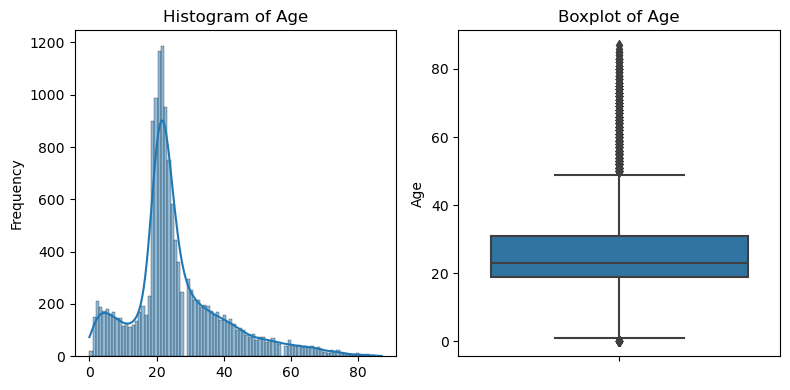

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


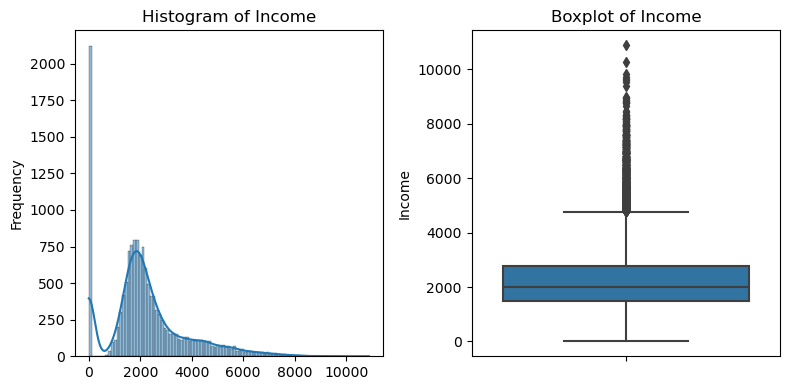

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


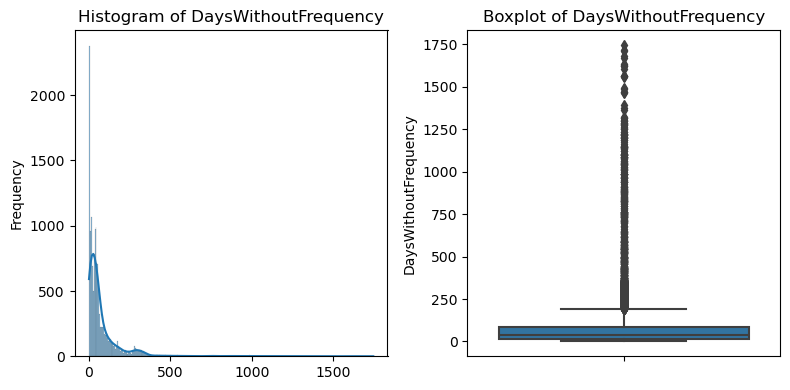

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


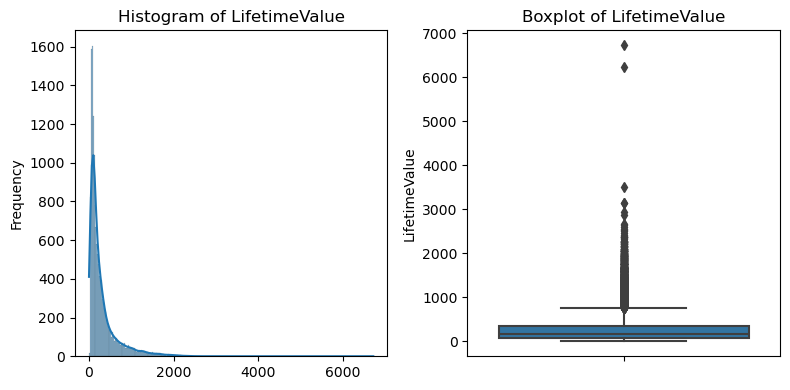

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


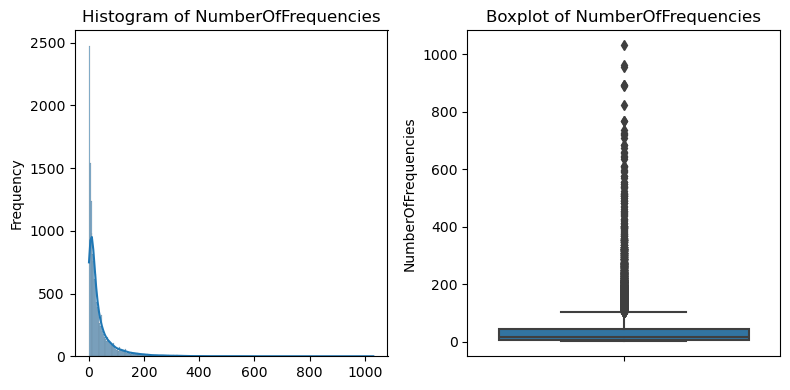

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


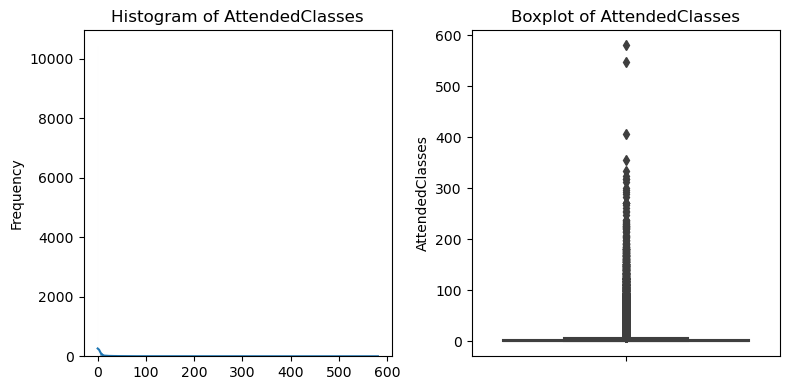

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


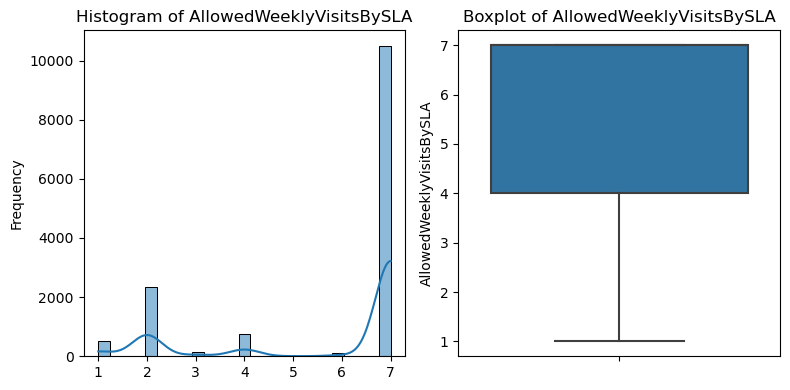

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


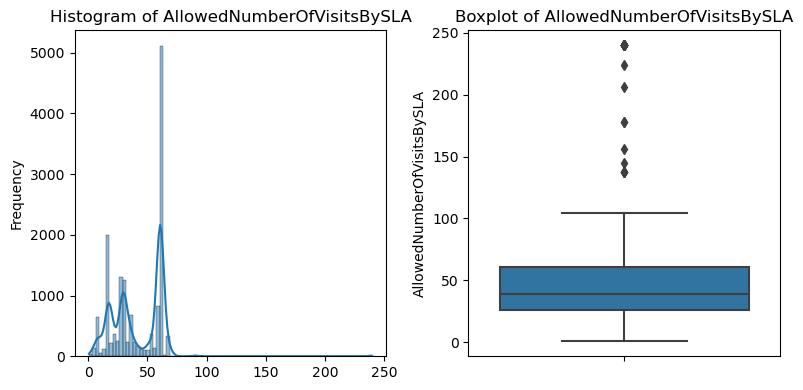

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


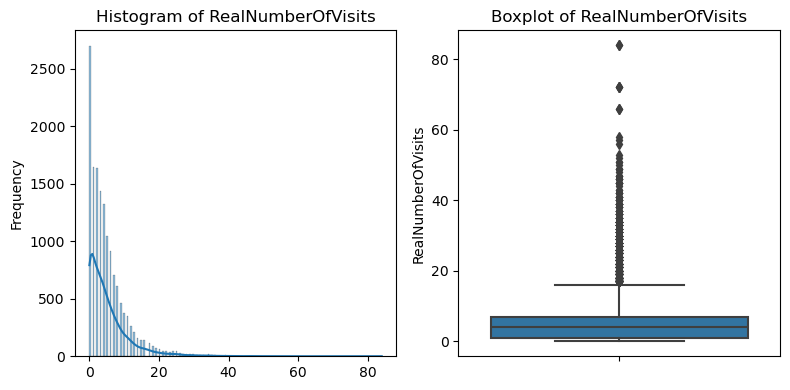

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


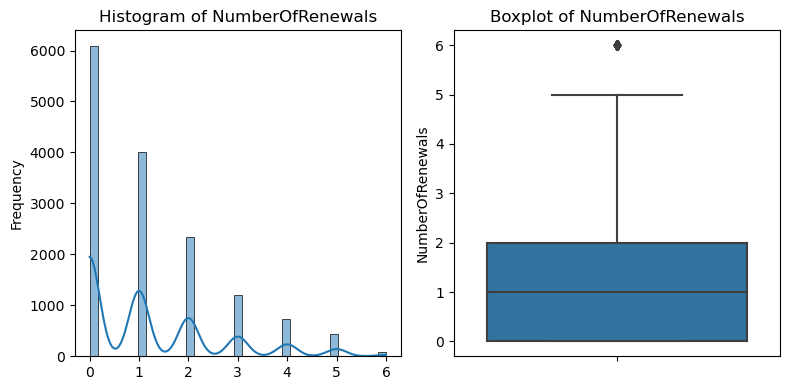

c:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


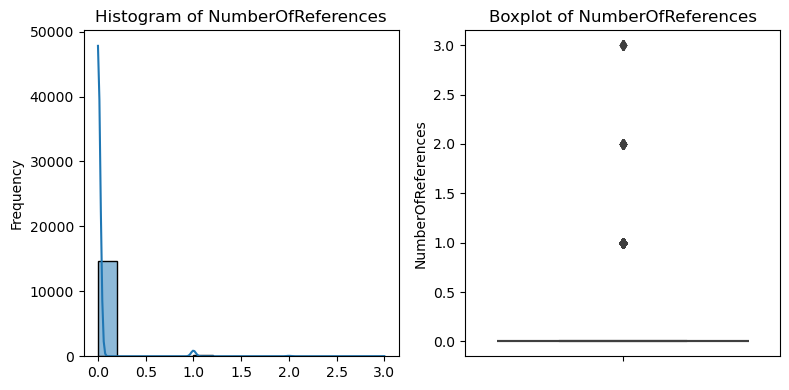

In [25]:
visualize_metric(data[metric_features])

### Binary Features

In [26]:
def visualize_binary(data):
    for col in data.columns.to_list():
        plt.figure(figsize=(5, 3))

        # Histogram
        sns.countplot(x = col, data=data)
        plt.title(f'Histogram of {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')

        plt.tight_layout()
        #plt.savefig(f"C:/Users/Utilizador/Desktop/MASTER/DM/PROJETO/figures/{col}_plot.png")
        plt.show()        
        plt.close()

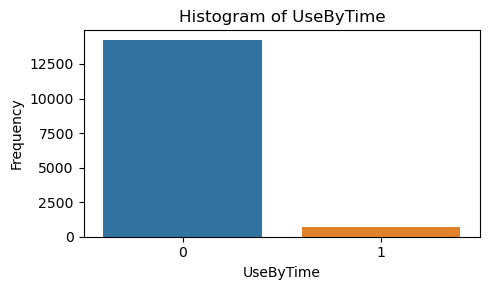

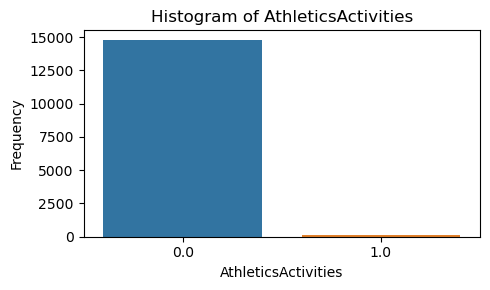

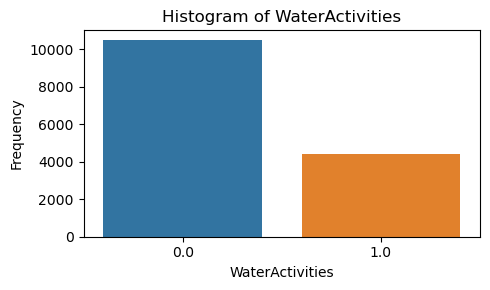

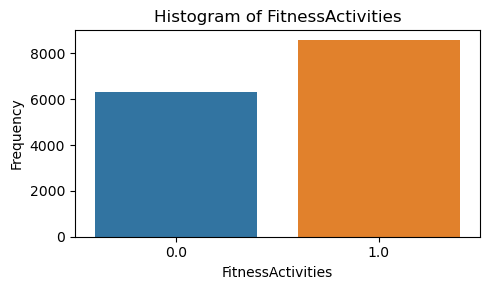

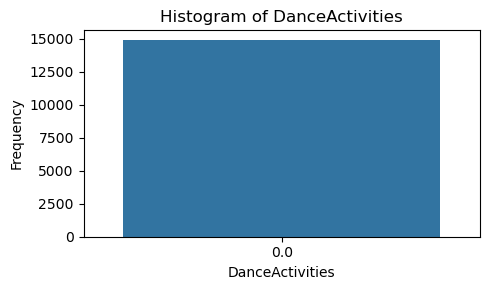

...

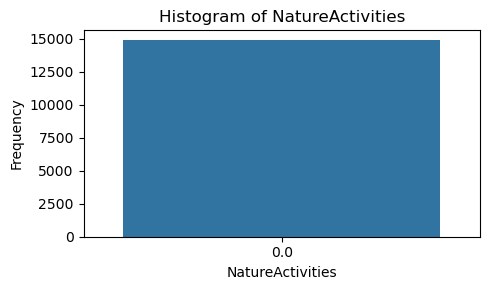

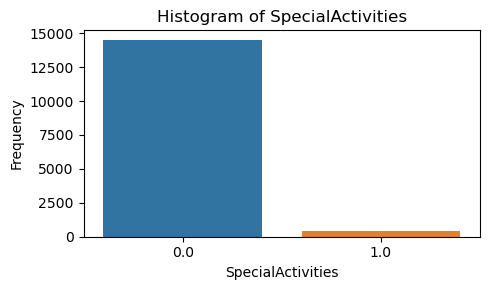

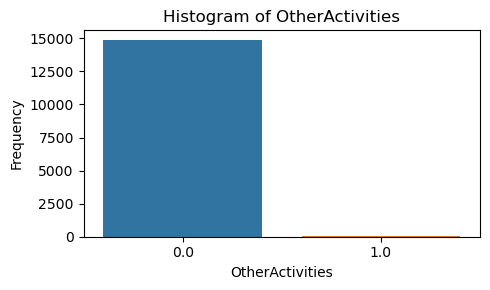

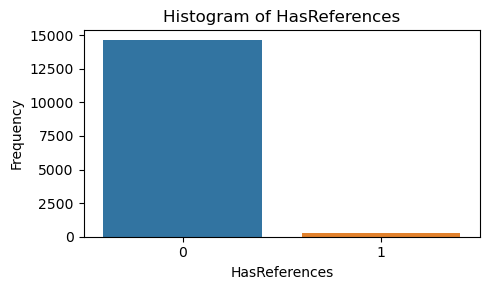

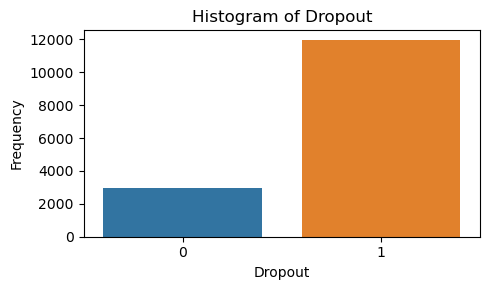

In [27]:
visualize_binary(data[binary_features])

<hr>
<a class="anchor" id="feat_change">

# 2.1  Understand the change in every feature by time
    
</a>

In [28]:
data2 = data.copy()

data2['EnrollmentStart'] = pd.to_datetime(data2['EnrollmentStart'])
data2['EnrollmentFinish'] = pd.to_datetime(data2['EnrollmentFinish'])

data2['DateActivityStart'] = data2['EnrollmentStart'].dt.to_period('M')
data2['DateActtivityFinish'] = data2['EnrollmentFinish'].dt.to_period('M')

#### Understand the number of current enrolled customers

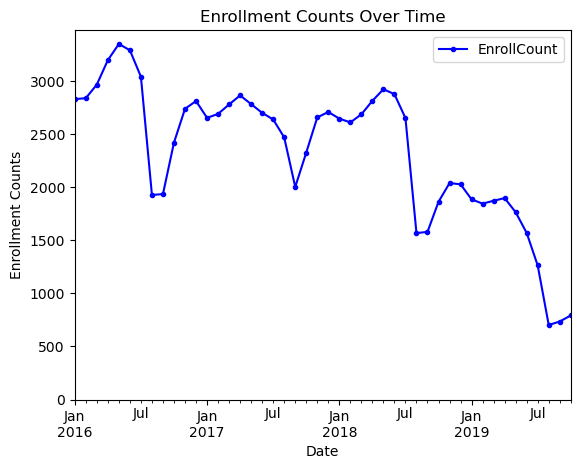

In [29]:
data2['EnrollmentStart'] = pd.to_datetime(data2['EnrollmentStart'])
data2['EnrollmentFinish'] = pd.to_datetime(data2['EnrollmentFinish'])

date_range = pd.date_range(start='2016-01-01', end='2019-10-31', freq='MS')

enrollment_counts = pd.DataFrame(index=date_range, columns=['EnrollCount'])
enrollment_counts['EnrollCount'] = 0

for _, row in data2.iterrows():
    start_date = row['EnrollmentStart']
    finish_date = row['EnrollmentFinish']
    
    # Filter the date range to only include months within the enrollment period
    mask = (date_range >= start_date) & (date_range <= finish_date)
    enrollment_counts.loc[mask, 'EnrollCount'] += 1

enrollment_counts.plot(kind='line', marker='.', color='blue')

#plt.figure(figsize=(10, 6))
#plt.fill_between(enrollment_counts.index, enrollment_counts['EnrollCount'], color='skyblue', alpha=0.4)
#plt.plot(enrollment_counts.index, enrollment_counts['EnrollCount'], color='Slateblue', alpha=0.8)

plt.title('Enrollment Counts Over Time')
plt.xlabel('Date')
plt.ylabel('Enrollment Counts')
plt.ylim(0)
plt.show()

#### Activities

Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings that are all parsable as floats or dates. If these strings should be plotted as numbers, cast to the appropriate data type before plotting.
Using categorical units to plot a list of strings 

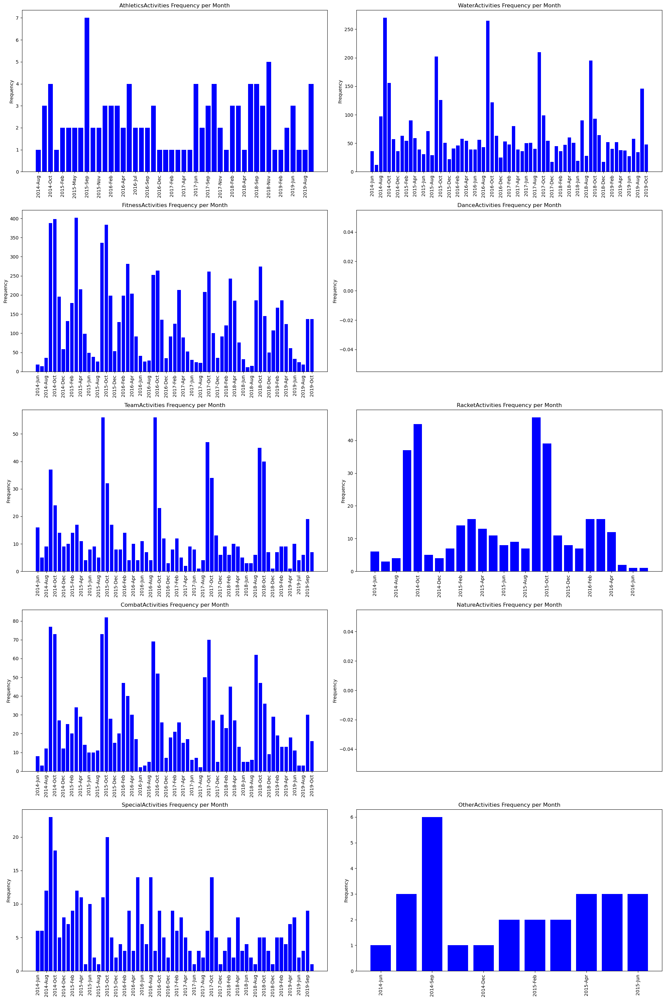

In [30]:
activities = ['AthleticsActivities', 'WaterActivities', 'FitnessActivities', 'DanceActivities', 'TeamActivities',
              'RacketActivities', 'CombatActivities', 'NatureActivities', 'SpecialActivities', 'OtherActivities']

num_rows = int(np.ceil(len(activities) / 2))
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(20, 6 * num_rows))

for i, activity in enumerate(activities):
    row = i // 2
    col = i % 2

    mask = (data2[activity] == 1)
    monthly_count = data2[mask].groupby('DateActivityStart').size()
    
    formatted_index = monthly_count.index.strftime('%Y-%b')

    axes[row, col].bar(formatted_index, monthly_count.values, color='blue')
    axes[row, col].set_xlabel('')
    axes[row, col].set_ylabel('Frequency')
    axes[row, col].set_title(f'{activity} Frequency per Month')
    axes[row, col].tick_params(axis='x', rotation=90)
    axes[row, col].set_xticks(np.arange(0, len(formatted_index), 2))
    axes[row, col].set_xticklabels(formatted_index[::2])

plt.tight_layout()
plt.show()

- As we can see theres some features that never had attendees (or there was never classes) and others that stopped working so doesn't make sense to study them anymore
- Drop: OtherActivities, NatureActivities, DanceActivities, RacketActivities

#### Other features
These individual analysis might help us for further analysis

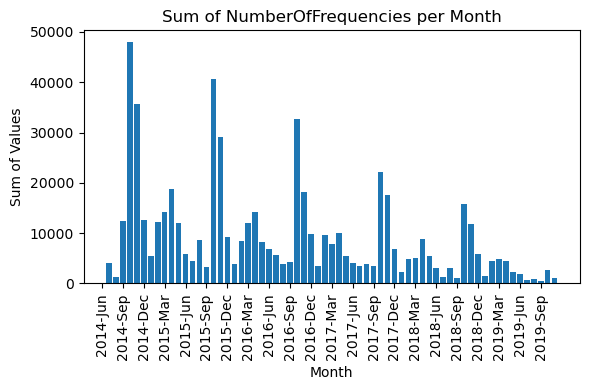

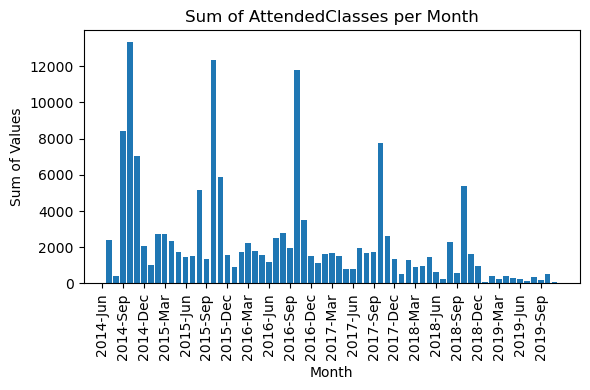

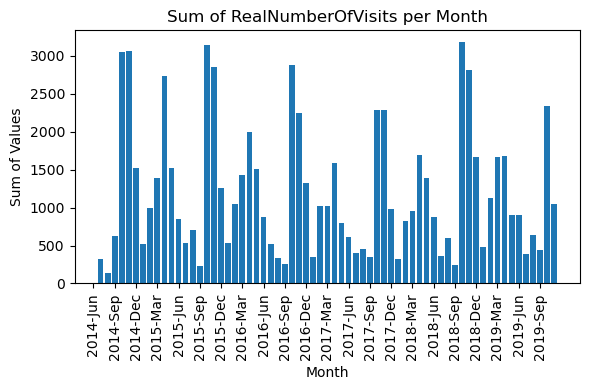

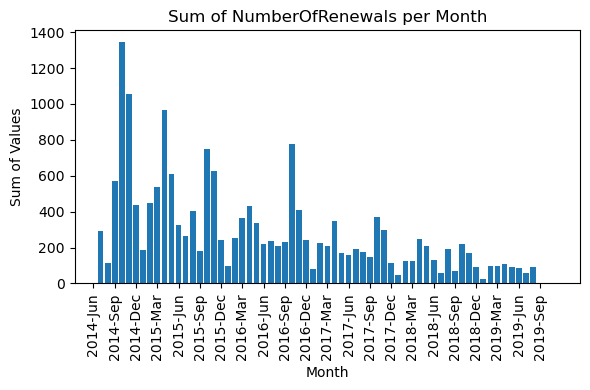

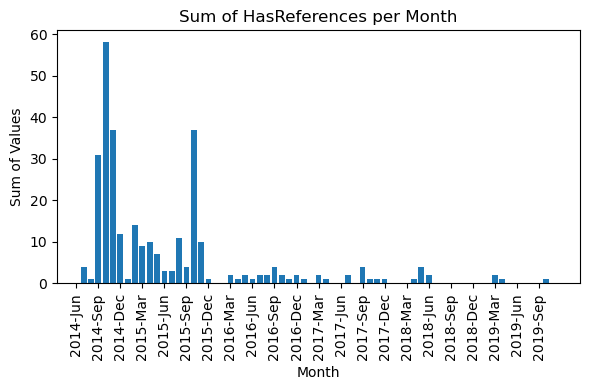

In [31]:
enrollment_averages = enrollment_counts.groupby(enrollment_counts.index.to_period('M')).mean()

plot_features = ['NumberOfFrequencies', 'AttendedClasses', 'RealNumberOfVisits', 'NumberOfRenewals', 'HasReferences']

for i in range(len(plot_features)):
    fig, axes = plt.subplots(figsize=(6,4))
    feature = plot_features[i]
            
    sum_per_month = data2.groupby('DateActivityStart')[feature].sum()
    
    plt.bar(range(1, len(sum_per_month) + 1), sum_per_month.values, label=f'Sum of {feature}')
    plt.title(f'Sum of {feature} per Month')
    plt.ylabel('Sum of Values')
    plt.xlabel('Month')
    formatted_index = sum_per_month.index.strftime('%Y-%b')
    plt.xticks(np.arange(0, len(formatted_index), 3), formatted_index[::3], rotation=90)
    
    plt.tight_layout()
    plt.show()

- As we can see theres values on NumberOfReferences after December 2015 that was the last one that had relevant values for HasReferences that means that HasReferences stopped being imported for the company

<hr>
<a class="anchor" id="prep">

# 3.  Data Preparation and Preprocessing
    
</a>


<a class="anchor" id="miss_val">

# 3.1. Handling Missing Values
    
</a>



For missing data imputation, we will use the most appropriate method according to the characteristics and distribution of each variable.

Let's start by having a visual exploration on this and check again the number of missing values, for each variable.

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=14.0.
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansDisplay.ttf', name='DejaVu Sans Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono-Bold.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', nam

findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\msyhbd.ttc', name='Microsoft YaHei', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GHAIMC.TTF', name='Guttman Haim-Condensed', style='normal', variant='normal', weight=400, stretch='condensed', size='scalable')) = 10.25
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\SCHLBKI.TTF', name='Century Schoolbook', style='italic', variant='normal', weight=400, stretch='normal', size='scalable')) = 11.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\GKAVLIT.TTF', name='Guttman Kav-Light', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\ERASBD.TTF', name='Eras Bold ITC', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='C:\\Windows\\Fonts\\seguihis.ttf', name='Segoe UI H

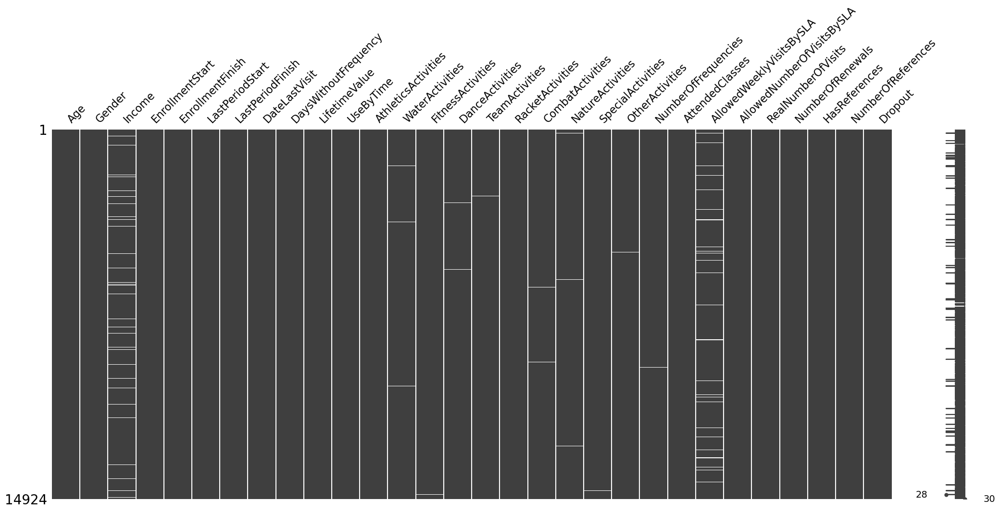

In [32]:
msno.matrix(data)
plt.show()

- Let's start by replacing empty strings (if exists) with missing values

In [33]:
data.replace("", np.nan, inplace=True) 
data.isna().sum()[data.isna().sum() > 0]

Income                      494
AthleticsActivities          36
WaterActivities              37
FitnessActivities            35
DanceActivities              36
TeamActivities               35
RacketActivities             37
CombatActivities             32
NatureActivities             47
SpecialActivities            44
OtherActivities              35
NumberOfFrequencies          26
AllowedWeeklyVisitsBySLA    530
dtype: int64

 - **Income**

<Axes: >

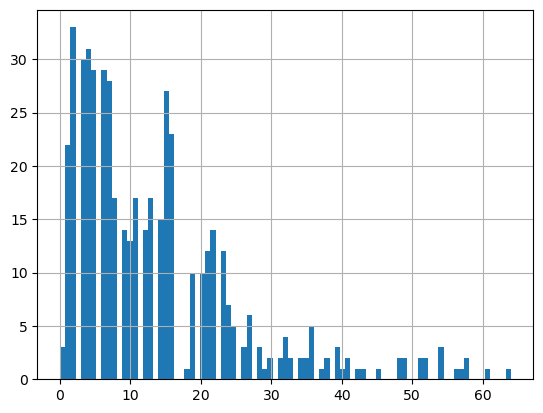

In [34]:
size_ = data["Age"].max()
data["Age"][data['Income'].isna()].hist(bins=size_)

- we figured that the fact that there is a missing value in income means that the person doesnt have income so all of the NA must be 0
or
- fill the age<18 with 0 and >18 with the median

In [35]:
data.loc[data['Age'] < 18, 'Income'] = 0

In [36]:
complete_cases = data.dropna(subset=['Income'])
incomplete_cases = data[data['Income'].isnull()]

if not incomplete_cases.empty and 'Age' in incomplete_cases.columns:
    # Step 3: Fit the linear regression model using complete cases
    model = LinearRegression()
    model.fit(complete_cases[['Age']], complete_cases['Income'])

    # Step 4: Predict the missing income values using the model
    predicted_income = model.predict(incomplete_cases[['Age']])

    data.loc[data['Income'].isnull(), 'Income'] = predicted_income
else:
    print("No missing income values to impute or missing age data for prediction.")

 - **NumberOfFrequencies**

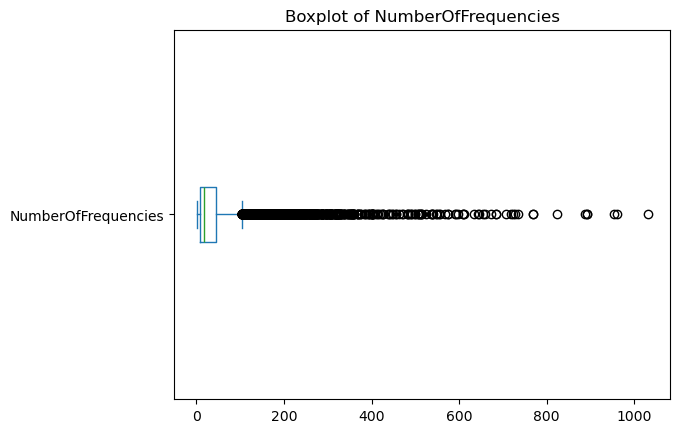

In [37]:
data['NumberOfFrequencies'].plot(kind='box', vert = False)
plt.title('Boxplot of NumberOfFrequencies')
plt.show()

In [38]:
data['NumberOfFrequencies'] = data['NumberOfFrequencies'].fillna(data['NumberOfFrequencies'].median())

We can fill these variable with the median because the distribution is symetrical

 - **AllowedWeeklyVisitsBySLA**
 
Filling AllowedWeeklyVisitsBySLA with a linear regression.
There are too many missing values, so we prefered to use linear regression over the median. There is a linear relationship between AllowedNumberOfVisitsBySLA and AllowedWeeklyVisitsBySLA, so linear regression can provide a simple and interpretable model.

Another possible, but less efficient approach is to use KNN.

In [39]:
print(f"The correlation between AllowedNumberOfVisitsBySLA and AllowedWeeklyVisitsBySLA is: {round(data[['AllowedWeeklyVisitsBySLA', 'AllowedNumberOfVisitsBySLA']].corr().values[::-1, ::-1][0, 1], 4)}.")

subset = data.dropna(subset=['AllowedWeeklyVisitsBySLA', 'AllowedNumberOfVisitsBySLA'])

model = LinearRegression()
model.fit(subset[['AllowedNumberOfVisitsBySLA']], subset['AllowedWeeklyVisitsBySLA'])
r_squared = model.score(subset[['AllowedNumberOfVisitsBySLA']], subset['AllowedWeeklyVisitsBySLA'])
print("R-squared:", round(r_squared, 4))
missing_subset = data[data['AllowedWeeklyVisitsBySLA'].isna()]

predicted_values = model.predict(missing_subset[['AllowedNumberOfVisitsBySLA']])

data.loc[data['AllowedWeeklyVisitsBySLA'].isna(), 'AllowedWeeklyVisitsBySLA'] = predicted_values

# Rounding every number to integers
data['AllowedNumberOfVisitsBySLA'] = data['AllowedNumberOfVisitsBySLA'].round().astype(int)
data['AllowedWeeklyVisitsBySLA'] = data['AllowedWeeklyVisitsBySLA'].round().astype(int)

The correlation between AllowedNumberOfVisitsBySLA and AllowedWeeklyVisitsBySLA is: 0.6747.
R-squared: 0.4553


### For Binary Features
 - **Activities**
 
We assumed that if theres no information regarding an Activity is because the person doesnt applied for that activity, otherwise it would be as a 1

In [40]:
bin_to_fill = ["WaterActivities","FitnessActivities","TeamActivities","RacketActivities","CombatActivities",
               "SpecialActivities",'AthleticsActivities','DanceActivities','NatureActivities','OtherActivities']
data[bin_to_fill]= data[bin_to_fill].fillna(0)

In [41]:
print(f"Values that the variable AthleticsActivities takes: {data.AthleticsActivities.unique()}. In which {round((1 - data.AthleticsActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable DanceActivities takes: {data.DanceActivities.unique()}. In which {round((1 - data.DanceActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable NatureActivities takes: {data.NatureActivities.unique()}. In which {round((1 - data.NatureActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable OtherActivities takes: {data.OtherActivities.unique()}. In which {round((1 - data.OtherActivities.sum()/len(data))*100,2)} % are zeros.")

print(f"Values that the variable TeamActivities takes: {data.TeamActivities.unique()}. In which {round((1 - data.TeamActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable RacketActivities takes: {data.RacketActivities.unique()}. In which {round((1 - data.RacketActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable CombatActivities takes: {data.CombatActivities.unique()}. In which {round((1 - data.CombatActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable SpecialActivities takes: {data.SpecialActivities.unique()}. In which {round((1 - data.SpecialActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable WaterActivities takes: {data.WaterActivities.unique()}. In which {round((1 - data.WaterActivities.sum()/len(data))*100,2)} % are zeros.")
print(f"Values that the variable FitnessActivities takes: {data.FitnessActivities.unique()}. In which {round((1 - data.FitnessActivities.sum()/len(data))*100,2)} % are zeros.")

Values that the variable AthleticsActivities takes: [0. 1.]. In which 99.26 % are zeros.
Values that the variable DanceActivities takes: [0.]. In which 100.0 % are zeros.
Values that the variable NatureActivities takes: [0.]. In which 100.0 % are zeros.
Values that the variable OtherActivities takes: [0. 1.]. In which 99.82 % are zeros.
Values that the variable TeamActivities takes: [0. 1.]. In which 94.47 % are zeros.
Values that the variable RacketActivities takes: [0. 1.]. In which 97.66 % are zeros.
Values that the variable CombatActivities takes: [0. 1.]. In which 89.23 % are zeros.
Values that the variable SpecialActivities takes: [0. 1.]. In which 97.35 % are zeros.
Values that the variable WaterActivities takes: [0. 1.]. In which 70.48 % are zeros.
Values that the variable FitnessActivities takes: [1. 0.]. In which 42.52 % are zeros.


In [42]:
data.isna().sum()[data.isna().sum() > 0]

Series([], dtype: int64)

<hr>
<a class="anchor" id="outliers">

# 3.2.  Handling Outliers
    
</a>

# Minimum and Maximum Values: 
Examine the minimum and maximum values to get an idea of the range of your data. If there are values that are significantly smaller or larger than the rest, they may be potential outliers.
# IQR (Interquartile Range): 
The describe method provides the 25th percentile (Q1) and the 75th (Q3), which you can use to calculate the IQR (IQR = Q3 - Q1). The IQR represents the range of values in the middle 50% of your data. Outliers are often defined as values that fall below Q1 - 1.5 * IQR or above Q3 + 1.5 * IQR. If you see values significantly below or above  these thresholds, they may be considered outliers.

In [43]:
data[metric_features + binary_features].describe(include = 'all').T

,count,mean,std,min,25%,50%,75%,max
Age,14924.0,26.018896,14.157192,0.0,19.0,23.000,31.0,87.0
Income,14924.0,2160.119898,1598.711351,0.0,1400.0,1960.000,2760.0,10890.0
DaysWithoutFrequency,14924.0,81.305883,144.266506,0.0,13.0,41.000,84.0,1745.0
LifetimeValue,14924.0,302.664769,364.404530,0.0,83.6,166.425,355.1,6727.8
NumberOfFrequencies,14924.0,40.087845,65.420517,1.0,7.0,18.000,45.0,1031.0
AttendedClasses,14924.0,10.153444,29.168237,0.0,0.0,0.000,3.0,581.0
AllowedWeeklyVisitsBySLA,14924.0,5.712544,2.103003,1.0,4.0,7.000,7.0,7.0
AllowedNumberOfVisitsBySLA,14924.0,41.639842,21.102458,1.0,26.0,39.000,61.0,240.0
RealNumberOfVisits,14924.0,5.307156,6.310065,0.0,1.0,4.000,7.0,84.0
NumberOfRenewals,14924.0,1.205910,1.381623,0.0,0.0,1.000,2.0,6.0


## Possible outliers
- DaysWithoutFrequency - based on mean compared to the median and max value
- LifetimeValue - based on mean compared to the median
- NumberOfFrequencies - based on mean compared to the median and max value
- AttendedClasses - based on mean compared to the median and max value
- AllowedNumberOfVisitsBySLA - based on max
- RealNumberOfVisits - based on max


Why do we need to remove outliers? Which methods can we use?

Let's start by "manually" filtering the dataset's outliers

In [44]:
data3 = data.copy()
# This may vary from session to session, and is prone to varying interpretations. The conditions were made based on just view.

filters3 = (
    (data3["DaysWithoutFrequency"] < 1400)
    & (data3["LifetimeValue"] < 2500)
    & (data3["NumberOfFrequencies"] < 700)
    & (data3["AttendedClasses"] < 200)
    & (data3["AllowedNumberOfVisitsBySLA"] < 150)
    & (data3["RealNumberOfVisits"] < 60)
)

data_out3 = data3[filters3]

print('Percentage of data kept after removing outliers:', np.round(data_out3.shape[0] / data3.shape[0], 4))

Percentage of data kept after removing outliers: 0.9921


#### IQR METHOD

In [45]:
data4 = data.copy()

# Calculate Q1, Q3, IQR
q25 = data4[metric_features].quantile(.25)
q75 = data4[metric_features].quantile(.75)
iqr = q75 - q25

# Compute upper and lower limit (lower_limit = Q1 -1.5*IQR | upper_limit = Q3 + 1.5*IQR)
upper_lim = q75 + 1.5 * iqr
lower_lim = q25 - 1.5 * iqr

filters4 = []
for metric in metric_features:
    llim = lower_lim[metric]
    ulim = upper_lim[metric]
    filters4.append(data4[metric].between(llim, ulim, inclusive = "both"))

filters4 = np.all(filters4, 0)
data_out4 = data4[filters4]
print('Percentage of data kept after removing outliers:', np.round(data_out4.shape[0] / data4.shape[0], 4))
#it is not acceptable to remove that many data

Percentage of data kept after removing outliers: 0.5567


It is not acceptable to remove 44.37% of data. A high percentage of removals may suggest that a significant portion of your data contains extreme values that are very different from the rest. Outlier removal can impact on analysis, it may lead to a loss of information and potentially bias, especially if the outliers contain valuable insights or represent valid observations.

#### Combining different outlier methods
More robust and consistent outlier detection method.

In [46]:
data5 = data[(filters3 | filters4)]
print('Percentage of data kept after removing outliers from both methods:', np.round(data5.shape[0] / data.shape[0], 7)-percentage_removed/100)

Percentage of data kept after removing outliers from both methods: 0.9909554912857238


In [47]:
tot_removed += len(data)-len(data_out3)
print("Removed:", len(data)-len(data_out3))
print("Total Removed:", tot_removed)
data = data[data.index.isin(data_out3.index)]

Removed: 118
Total Removed: 136


We deleted less than 1% of the data because we wanted to see multidimensional outliers with dbscan later

<hr>
<a class="anchor" id="bi_outliers">

# 3.3.  Handling Bivariate Outliers
    
</a>

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=12.0.
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansDisplay.ttf', name='DejaVu Sans Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono-Bold.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', nam

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=11.0.
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansDisplay.ttf', name='DejaVu Sans Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono-Bold.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', nam

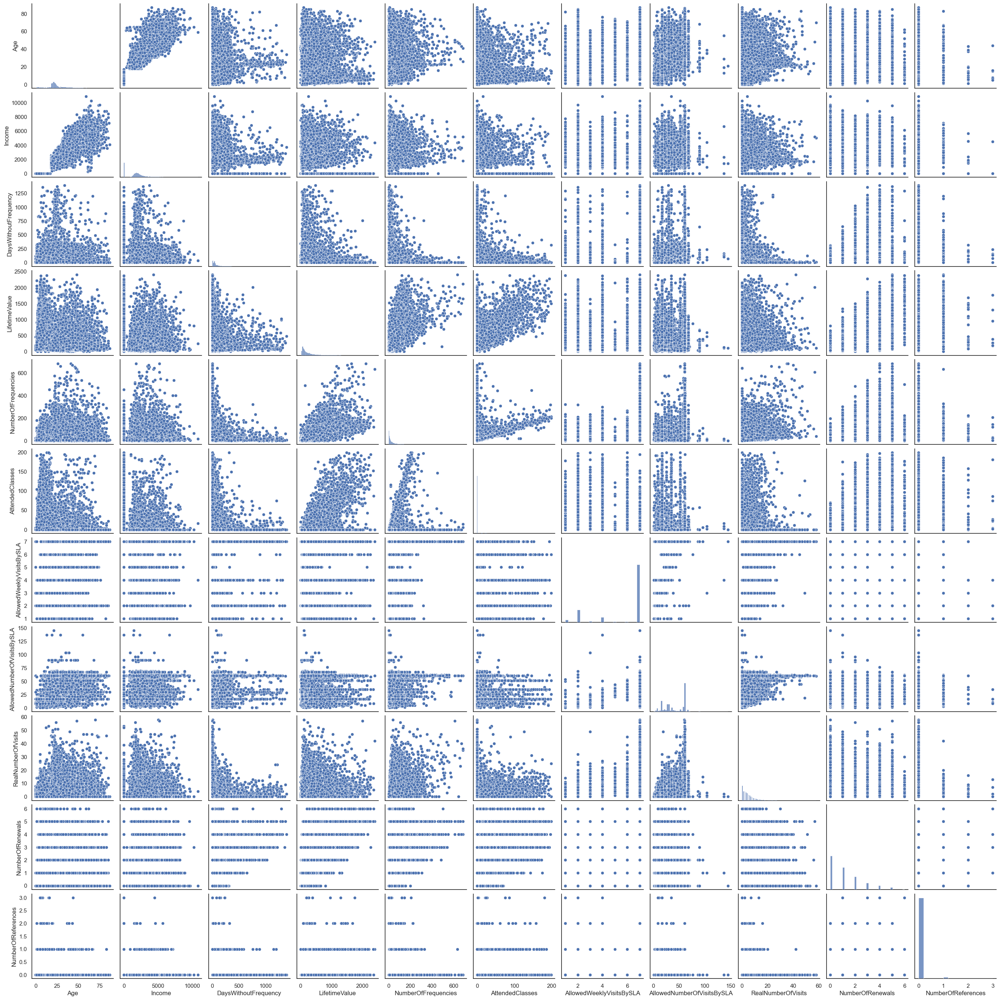

findfont: Matching sans\-serif:style=normal:variant=normal:weight=normal:stretch=normal:size=12.0.
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXSizTwoSymBol.ttf', name='STIXSizeTwoSym', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansDisplay.ttf', name='DejaVu Sans Display', style='normal', variant='normal', weight=400, stretch='normal', size='scalable')) = 10.05
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\DejaVuSansMono-Bold.ttf', name='DejaVu Sans Mono', style='normal', variant='normal', weight=700, stretch='normal', size='scalable')) = 10.335
findfont: score(FontEntry(fname='c:\\ProgramData\\anaconda3\\Lib\\site-packages\\matplotlib\\mpl-data\\fonts\\ttf\\STIXNonUni.ttf', nam

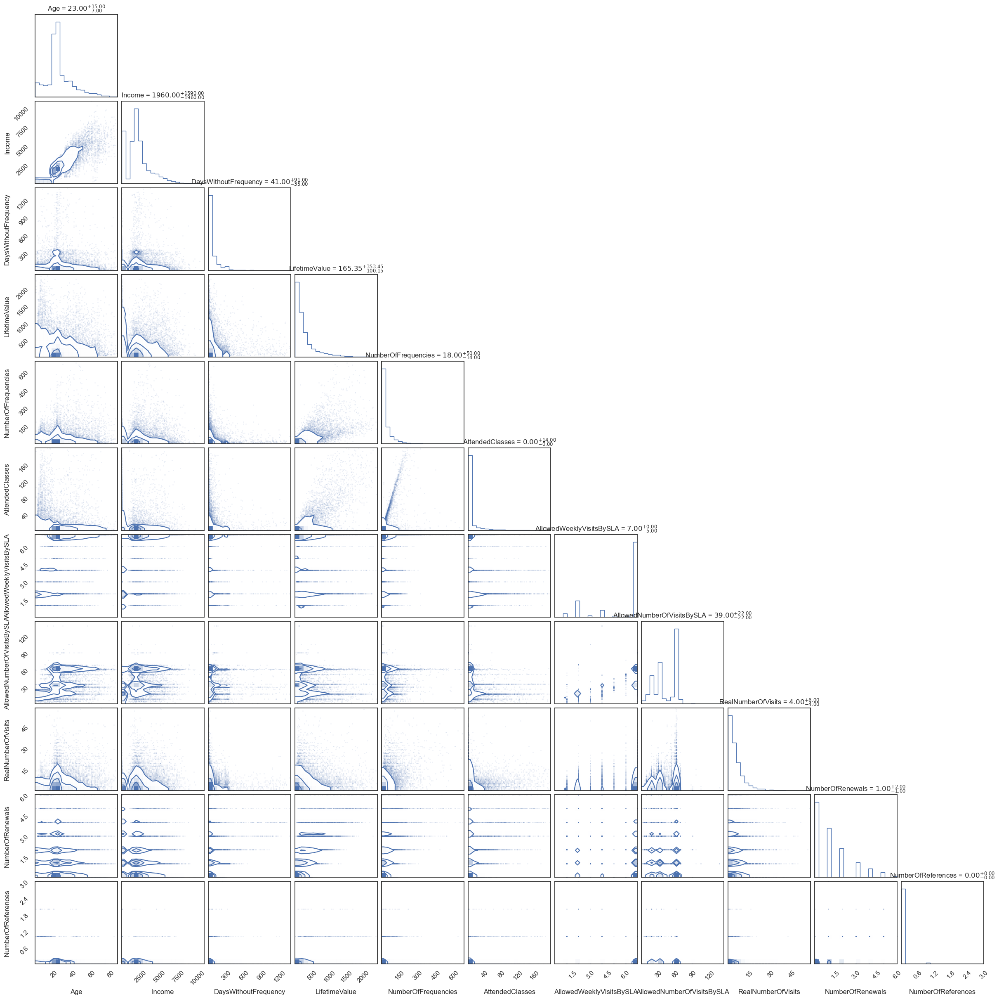

In [48]:
sns.set(style="white")
pairplot = sns.pairplot(data[metric_features])

lower_triangle_data = np.tril(pairplot.data, k=-1)
lower_triangle_df = pd.DataFrame(lower_triangle_data, columns=metric_features)

corner.corner(lower_triangle_df, color='b', labels=lower_triangle_df.columns, show_titles=True, title_fmt='.2f')
plt.show()

### Self-Organizing Maps

- **Data Preparation**: Extracts numeric columns from a DataFrame and normalizes the data to a range between 0 and 1.

- **SOM Initialization and Training**: Initializes a Self-Organizing Map (SOM) with a specified grid size. Randomly initializes weights and trains the SOM using the normalized numeric data.

 - **Visualization**: For each feature, displays a 2D heatmap on the SOM grid. Adjustments can be made to parameters like grid size, sigma, learning rate, and training epochs based on specific needs. The code uses the MiniSom library for SOM implementation and Matplotlib for visualization.
 
 It represents the distances between neurons.

In [49]:
data_som_scaled = data[metric_features].copy()
scaler = StandardScaler()
scaled_feat = scaler.fit_transform(data_som_scaled[metric_features])
data_som_scaled[metric_features] = scaled_feat

np.random.seed(42)

sm = sompy.SOMFactory().build(
    data_som_scaled[metric_features].values, 
    mapsize=[50, 50], initialization='random', 
    neighborhood='gaussian', training='batch',
    lattice='hexa', component_names=metric_features
)
sm.train(n_job=4, verbose='info', train_rough_len=25, train_finetune_len=25)

plt.rcParams['figure.dpi'] = 72

 Training...
 random_initialization took: 0.000000 seconds
 Rough training...
 radius_ini: 17.000000 , radius_final: 2.833333, trainlen: 25

 epoch: 1 ---> elapsed time:  0.573000, quantization error: 5.261863

 epoch: 2 ---> elapsed time:  0.634000, quantization error: 2.857293

 epoch: 3 ---> elapsed time:  0.585000, quantization error: 2.839302

 epoch: 4 ---> elapsed time:  0.525000, quantization error: 2.829937

 epoch: 5 ---> elapsed time:  0.550000, quantization error: 2.817276

 epoch: 6 ---> elapsed time:  0.523000, quantization error: 2.803669

 epoch: 7 ---> elapsed time:  0.510000, quantization error: 2.790937

 epoch: 8 ---> elapsed time:  0.556000, quantization error: 2.780870

 epoch: 9 ---> elapsed time:  0.558000, quantization error: 2.772077

 epoch: 10 ---> elapsed time:  0.542000, quantization error: 2.762606

 epoch: 11 ---> elapsed time:  0.652000, quantization error: 2.752055

 epoch: 12 ---> elapsed time:  0.548000, quantization error: 2.739977

 epoch: 13 ---> 

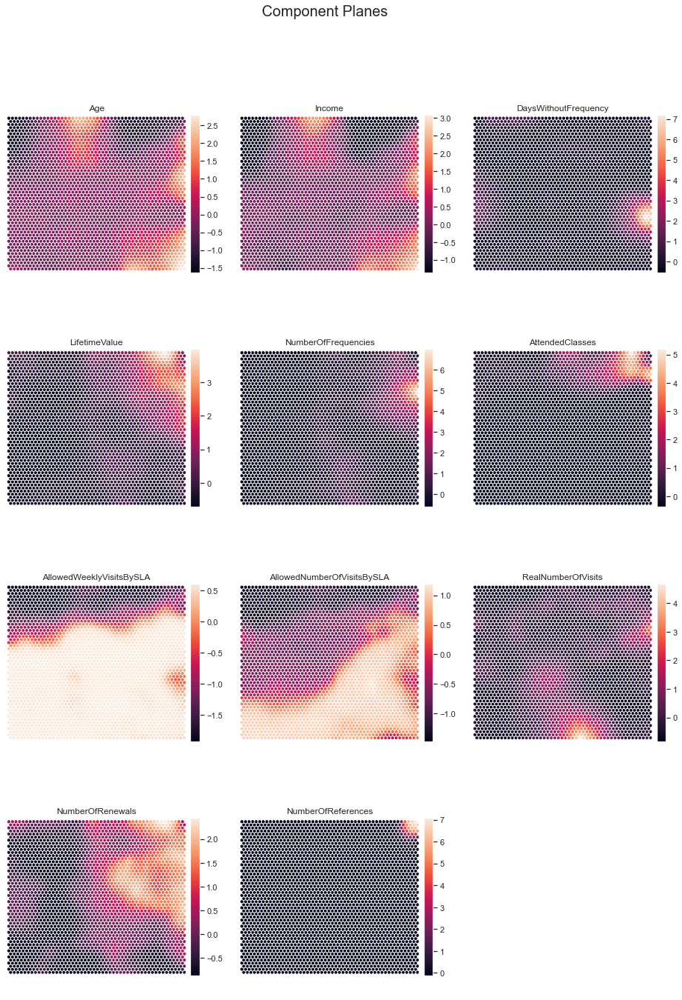

In [50]:
# Visualizing the Component planes (feature values)
sns.set()
view2D = View2D(12, 12, "", text_size=10)
view2D.show(sm, col_sz=3, what='codebook')
plt.subplots_adjust(top=0.90)
plt.suptitle("Component Planes", fontsize=20)
plt.show()

<hr>
<a class="anchor" id="feat_eng_oh">

# 3.4.  Feature Engineering, One-Hot Encoding
    
</a>

 - **Gender**
 
Transforming the variable Gender into a binary feature is more important then have the full description of the variable.

In [51]:
data.Gender.value_counts()

Gender
Female    8863
Male      5943
Name: count, dtype: int64

In [52]:
gender_data = data['Gender']

# Perform one-hot encoding using Pandas get_dummies
ohc_df = pd.get_dummies(gender_data, drop_first=True, prefix='Gender').astype(int)

data["Gender_Male"] = ohc_df
data = data.drop(["Gender"], axis=1)
non_metric_features.remove("Gender")
binary_features.append("Gender_Male")
data["Gender_Male"].value_counts()

Gender_Male
0    8863
1    5943
Name: count, dtype: int64

Transformation of variables in order to reduce the input space
- **EnrollmentTime** = EnrollmentFinish - EnrollmentStart, represents the amount of time the costumer was enrolled

(Days without visit = EnrollmentFinish - Date Last Visit)

In [53]:
data['EnrollmentTime'] = (pd.to_datetime(data['EnrollmentFinish']) - pd.to_datetime(data['EnrollmentStart'])).dt.days

- **ContractPeriod** represents the Total of semesters according to the last contract

In [54]:
data["LastPeriodTime"] = (pd.to_datetime(data['LastPeriodFinish']) - pd.to_datetime(data['LastPeriodStart'])).dt.days
data["ContractPeriod"] = data["LastPeriodTime"].apply(lambda x: 1 if x//30 == 6 else 2 if x//30 == 12 else 3 if x//30 == 18 else 0)

data["ContractPeriod"].value_counts()
# Total of semesters according to the last contract

ContractPeriod
1    9417
2    5352
3      37
Name: count, dtype: int64

In [55]:
data["StillEnrolled"] = np.where((data["EnrollmentStart"] == data["EnrollmentFinish"]) & (data["Dropout"] == 0), 1, 0)

In [56]:
data["StillEnrolled"].value_counts()

StillEnrolled
0    12444
1     2362
Name: count, dtype: int64

In [57]:
mask = data["StillEnrolled"] == True 

enrollment_time = pd.to_datetime("2019-10-31") - pd.to_datetime(data.loc[mask, 'EnrollmentStart'])
data.loc[mask, 'EnrollmentTime'] = enrollment_time.dt.days

- Create the **TotalSemesters** variable that represents the amount of semesters that someone was enrolled 

In [58]:
data['EnrollmentStart'] = pd.to_datetime(data['EnrollmentStart'])
data['LastPeriodStart'] = pd.to_datetime(data['LastPeriodStart'])

#BLR stands for before last renewal
data["TotalTime_BLR"] = (pd.to_datetime(data['LastPeriodStart']) - pd.to_datetime(data['EnrollmentStart'])).dt.days
data["TotalTime_BLR"] = data.apply(lambda row: 0 if row["TotalTime_BLR"] < 0 or row["StillEnrolled"] == 1 else row["TotalTime_BLR"], axis=1)
data["TotalSemesters_BLR"] = data["TotalTime_BLR"] // 180 
# (180 = 30*6)
data["TotalSemesters_BLR"] = data.apply(lambda row: row["TotalSemesters_BLR"] + 1 if row["EnrollmentStart"] < row["LastPeriodStart"] else row["TotalSemesters_BLR"], axis=1)

data["TotalSemesters"] = data["ContractPeriod"] + data["TotalSemesters_BLR"]
data["TotalSemesters"] = data.apply(lambda row: row["TotalSemesters"] + row["NumberOfRenewals"] if row["StillEnrolled"] == 1 else row["TotalSemesters"], axis=1)
data["TotalSemesters"].value_counts()

TotalSemesters
2     4288
1     3440
3     2727
4     1401
5     1063
6      680
7      617
8      255
9      192
10      78
11      62
12       3
Name: count, dtype: int64

In [59]:
data = data.drop(['LastPeriodTime','ContractPeriod','TotalTime_BLR','TotalSemesters_BLR'], axis = 1)

We can drop these variables because they were just used for auxiliary calc

- **EnrolledMonthlyVisits** represents the average amount of times that visits the facilities

In [60]:
data["EnrollmentStart"] = pd.to_datetime(data["EnrollmentStart"])

for index, row in data.iterrows():
    if row["EnrollmentTime"] == 0:
        data.loc[index, "EnrolledMonthlyVisits"] = (30 * row["NumberOfFrequencies"] / (datetime(2019, 10, 31) - row["EnrollmentStart"]).days)
    else:
        data.loc[index, "EnrolledMonthlyVisits"] = (30 * row["NumberOfFrequencies"] / row["EnrollmentTime"]) 

 - **TotalActivities**

In [61]:
data["TotalActivities"] = data[['AthleticsActivities', 'WaterActivities','FitnessActivities', 'DanceActivities',
            'TeamActivities','RacketActivities', 'CombatActivities', 'NatureActivities','SpecialActivities', 'OtherActivities']].sum(axis = 1, skipna = True)
data["TotalActivities"].value_counts()

TotalActivities
1.0    13502
2.0     1159
3.0       95
0.0       39
4.0        9
5.0        2
Name: count, dtype: int64

In [62]:
metric_features.append("TotalActivities")
metric_features.append("EnrollmentTime")
metric_features.append("TotalSemesters")
metric_features.append("EnrolledMonthlyVisits")

binary_features.append("StillEnrolled")

In [63]:
ftp = ["TotalActivities", "EnrollmentTime","TotalActivities","TotalSemesters","EnrolledMonthlyVisits"]
btp = ["StillEnrolled"]

<hr>
<a class="anchor" id="feat_selection">

# 4.  Feature Selection 
    
</a>

In [64]:
pd.set_option('display.max_columns', None)
data.head(3)

,Age,Income,EnrollmentStart,EnrollmentFinish,LastPeriodStart,LastPeriodFinish,DateLastVisit,DaysWithoutFrequency,LifetimeValue,UseByTime,AthleticsActivities,WaterActivities,FitnessActivities,DanceActivities,TeamActivities,RacketActivities,CombatActivities,NatureActivities,SpecialActivities,OtherActivities,NumberOfFrequencies,AttendedClasses,AllowedWeeklyVisitsBySLA,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,HasReferences,NumberOfReferences,Dropout,Gender_Male,EnrollmentTime,StillEnrolled,TotalSemesters,EnrolledMonthlyVisits,TotalActivities
ID,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
10000,60,5500.0,2019-09-03,2019-10-31,2019-07-01,2019-12-31,2019-10-30,1,89.35,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,7,3,6,2,0,0,0,0,0,58,0,1,4.655172,1.0
10001,29,2630.0,2014-08-12,2015-09-14,2015-01-01,2015-12-31,2015-07-16,60,479.20,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,23.0,1,2,17,1,2,0,0,1,0,398,0,3,1.733668,1.0
10002,23,1980.0,2017-05-02,2017-06-01,2017-01-01,2017-06-30,2017-05-25,7,37.60,0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0,7,30,6,0,0,0,1,1,30,0,1,6.000000,1.0


We've seen before in the visualization that there is something wrong with the following variables: AthleticsActivities, DanceActivities, NatureActivities and OtherActivities.


##### Activities

- there are 39 clients who have never assigned for an activity
- the marketing strategies are making costumers to enroll

In [65]:
data[['AthleticsActivities','DanceActivities', 'NatureActivities', "RacketActivities", "OtherActivities"]].describe().T

,count,mean,std,min,25%,50%,75%,max
AthleticsActivities,14806.0,0.007159,0.084312,0.0,0.0,0.0,0.0,1.0
DanceActivities,14806.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
NatureActivities,14806.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0
RacketActivities,14806.0,0.023504,0.151503,0.0,0.0,0.0,0.0,1.0
OtherActivities,14806.0,0.001824,0.042666,0.0,0.0,0.0,0.0,1.0


As we suspected, the variables have a lot of unique values for these variables (because of the variance tresholding).

It seems the variables we suspected may contain insignificant information as they are predominantly populated with zeros. Hence, we can confidently consider removing these variables from the analysis.
We will probably drop them after

#### We've decided that we can remove these variables for before any feature selection

In [66]:
data = data.drop(['AthleticsActivities','DanceActivities', 'NatureActivities', "OtherActivities", "RacketActivities"
                  ,'EnrollmentStart', 'EnrollmentFinish', 'LastPeriodStart', 'LastPeriodFinish', 'DateLastVisit'
                 ], axis = 1)

binary_features.remove("AthleticsActivities")
binary_features.remove("DanceActivities")
binary_features.remove("NatureActivities")
binary_features.remove("RacketActivities")
binary_features.remove("OtherActivities")

non_metric_features.remove("EnrollmentStart")
non_metric_features.remove("EnrollmentFinish")
non_metric_features.remove("LastPeriodStart")
non_metric_features.remove("LastPeriodFinish")
non_metric_features.remove("DateLastVisit")

In [67]:
data.describe(include = "all").T

,count,mean,std,min,25%,50%,75%,max
Age,14806.0,25.982980,14.122927,0.000000,19.000000,23.000000,31.000000,87.000000
Income,14806.0,2156.798551,1593.677332,0.000000,1400.000000,1960.000000,2753.347398,10890.000000
DaysWithoutFrequency,14806.0,79.504052,133.827736,0.000000,13.000000,41.000000,83.000000,1392.000000
LifetimeValue,14806.0,295.135121,340.658699,0.000000,83.600000,165.375000,353.200000,2406.850000
UseByTime,14806.0,0.046940,0.211518,0.000000,0.000000,0.000000,0.000000,1.000000
WaterActivities,14806.0,0.292584,0.454964,0.000000,0.000000,0.000000,1.000000,1.000000
FitnessActivities,14806.0,0.577334,0.494000,0.000000,0.000000,1.000000,1.000000,1.000000
TeamActivities,14806.0,0.055180,0.228340,0.000000,0.000000,0.000000,0.000000,1.000000
CombatActivities,14806.0,0.107389,0.309617,0.000000,0.000000,0.000000,0.000000,1.000000
SpecialActivities,14806.0,0.025868,0.158746,0.000000,0.000000,0.000000,0.000000,1.000000


<hr>
<a class="anchor" id="filter_methods">

# 4.1. Filter Methods
    
</a>

Let's explore some statistics about the structure of data.

 - **Variance Tresholding**

In [68]:
feature_variances = data.var(numeric_only=True).apply(lambda x: '{:.6f}'.format(x))
feature_variances

Age                               199.457056
Income                        2539807.438586
DaysWithoutFrequency            17909.862969
LifetimeValue                  116048.349084
UseByTime                           0.044740
WaterActivities                     0.206993
FitnessActivities                   0.244036
TeamActivities                      0.052139
CombatActivities                    0.095863
SpecialActivities                   0.025200
NumberOfFrequencies              3444.003143
AttendedClasses                   617.938570
AllowedWeeklyVisitsBySLA            4.417313
AllowedNumberOfVisitsBySLA        385.684341
RealNumberOfVisits                 36.674942
NumberOfRenewals                    1.850126
HasReferences                       0.018750
NumberOfReferences                  0.027226
Dropout                             0.157883
Gender_Male                         0.240293
EnrollmentTime                 179002.211499
StillEnrolled                       0.134089
TotalSemes

The features with a lower variance across the dateset because are less informative and don't contribute much to the overall clustering.

<hr>
<a class="anchor" id="red_vs_rel">

# 4.2.  Redundancy vs Relevancy
    
</a>

- **Correlation Analysis**

High correlation among features might imply redundancy and it might not add much unique information to the model. Setting a correlation treshold helps in avoiding multicolinearity. Identifying groups of features that are strongly correlated and consider only one representative from each group.

###### Disadvantages of this analysis:
 - correlation might be sensitive to outliers.

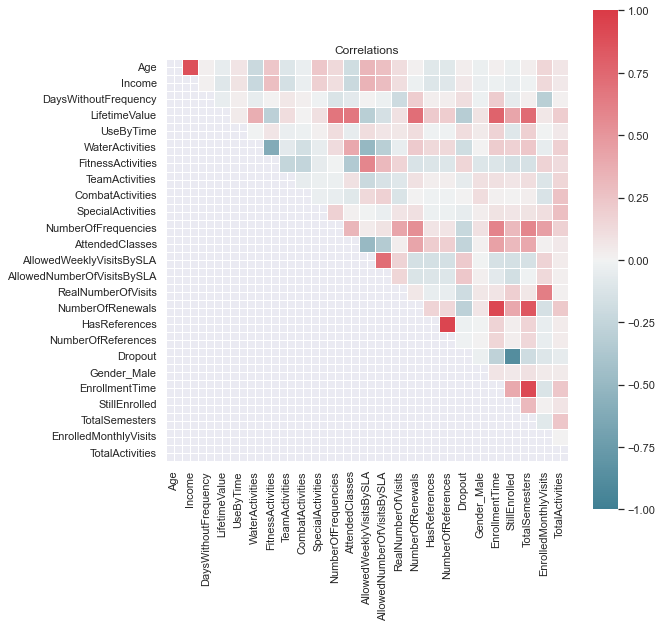

In [69]:
fig, ax = plt.subplots(figsize=(9,9))

corr = data.corr(method="pearson")

mask_lower = np.tril(np.ones_like(corr, dtype=bool))

sns.heatmap(data=corr, cmap=sns.diverging_palette(220, 10, as_cmap=True),
            fmt='', vmin=-1, vmax=1, center=0, square=True, linewidths=.5, mask=mask_lower, ax=ax)

plt.title('Correlations')
plt.show()

In [70]:
corr = data.corr(method="spearman")
upper_tri_indices = corr.where(np.triu(np.ones(corr.shape), k=1).astype(bool))

s = upper_tri_indices.unstack()
so = round(s.sort_values(),4)
high_pairs_p = so[(so > 0.60)] 
high_pairs_n = so[(so < -0.60)]
high_pairs_p, high_pairs_n

(NumberOfRenewals            LifetimeValue               0.6617
 EnrollmentTime              NumberOfFrequencies         0.6730
 TotalSemesters              NumberOfFrequencies         0.6754
 AllowedNumberOfVisitsBySLA  AllowedWeeklyVisitsBySLA    0.7089
 NumberOfFrequencies         LifetimeValue               0.7408
 TotalSemesters              NumberOfRenewals            0.7664
 EnrollmentTime              LifetimeValue               0.8013
 TotalSemesters              LifetimeValue               0.8187
 EnrollmentTime              NumberOfRenewals            0.8718
 Income                      Age                         0.8778
 TotalSemesters              EnrollmentTime              0.8796
 NumberOfReferences          HasReferences               1.0000
 dtype: float64,
 StillEnrolled             Dropout           -0.8811
 AllowedWeeklyVisitsBySLA  AttendedClasses   -0.8181
 FitnessActivities         WaterActivities   -0.6155
 dtype: float64)

# U-map

In [71]:
data_standard = data.copy()

scaler = StandardScaler()
scaled_feat = scaler.fit_transform(data_standard[metric_features])

data_standard[metric_features] = scaled_feat

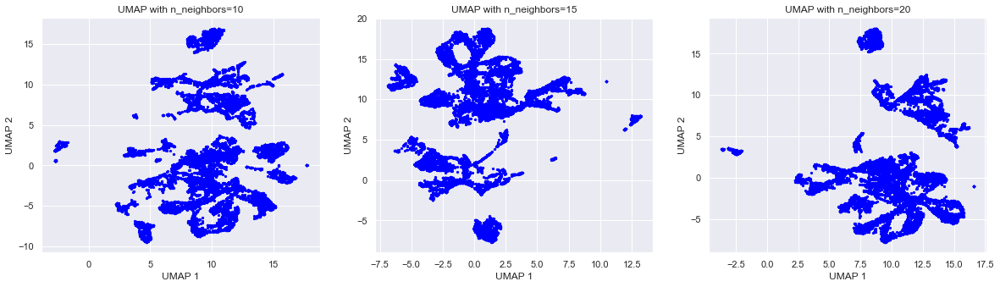

In [72]:
n_neighbors_values = [10, 15, 20] # Define your sets of parameters
n_components = 2 # Fixed n_components at 2 for 2D visualization
fig, subplots = plt.subplots(1, len(n_neighbors_values), figsize=(20, 5))

for i, n_neighbors in enumerate(n_neighbors_values):
    # Apply UMAP
    reducer = umap.UMAP(n_neighbors=n_neighbors, n_components=n_components)
    embedding = reducer.fit_transform(data_standard)
    
    ax = subplots[i]
    
    # Scatter plot
    scatter = ax.scatter(embedding[:, 0], embedding[:, 1], c='blue', s=5)  # Uniform color
    
    # Formatting the plots
    ax.set_title(f'UMAP with n_neighbors={n_neighbors}')
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')

plt.show()

Plot for every labels

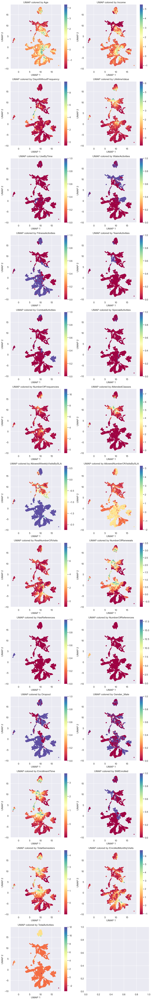

In [73]:
X_np = data_standard.to_numpy()
n_neighbors = 15  # Set your n_neighbors value
n_components = 2

reducer = umap.UMAP(n_neighbors=n_neighbors, n_components=n_components)   # Create a UMAP reducer

embedding = reducer.fit_transform(X_np)  # Fit and transform the data

# Plotting
num_features = len(data_standard.columns)
num_rows = (num_features + 1) // 2  # Calculate the number of rows needed

fig, axes = plt.subplots(num_rows, ncols=2, figsize=(10, 5 * num_rows))

for i, col_name in enumerate(data_standard.columns):  
    row, col = divmod(i, 2)  # Determine the row and column position for the subplot
    ax = axes[row, col]  # Get the subplot at the correct position
    
    colors = X_np[:, i]  # Use the ith column as color
    
    # Scatter plot
    scatter = ax.scatter(embedding[:, 0], embedding[:, 1], c=colors, cmap='Spectral', s=5)
    
    # Formatting the plots
    ax.set_title(f'UMAP colored by {col_name}')  
    ax.set_xlabel('UMAP 1')
    ax.set_ylabel('UMAP 2')
    fig.colorbar(scatter, ax=ax)  # Add color bar for reference

plt.tight_layout()
plt.show()

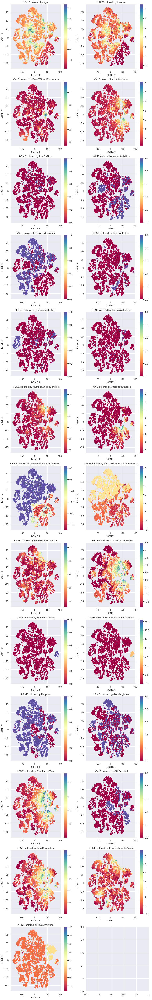

In [74]:
X_np = data_standard.to_numpy()

n_comp = 2  # for 2D visualization
perp = 30  # common default; adjust based on dataset size and complexity
l_rate = 200  # typical values range between 10 and 1000

tsne = TSNE(n_components=n_comp, perplexity=perp, learning_rate=l_rate, random_state=42)   # Create a t-SNE reducer

embedding = tsne.fit_transform(X_np)  # Fit and transform the data with t-SNE

num_features = len(data_standard.columns)
num_rows = (num_features + 1) // 2 

fig, axes = plt.subplots(num_rows, ncols=2, figsize=(10, 5 * num_rows))

for i, col_name in enumerate(data_standard.columns):  
    row, col = divmod(i, 2)  # Determine the row and column position for the subplot
    ax = axes[row, col]  # Get the subplot at the correct position
    
    colors = X_np[:, i]  # Use the ith column as color
    
    # Scatter plot for t-SNE
    scatter = ax.scatter(embedding[:, 0], embedding[:, 1], c=colors, cmap='Spectral', s=5)
    
    # Formatting the plots
    ax.set_title(f't-SNE colored by {col_name}')  
    ax.set_xlabel('t-SNE 1')
    ax.set_ylabel('t-SNE 2')
    fig.colorbar(scatter, ax=ax)  # Add color bar for reference

plt.tight_layout()
plt.show()

# Choosing the variables that we want to keep

In [75]:
data = data.drop(['Income','AllowedWeeklyVisitsBySLA', 'TotalSemesters', 'HasReferences','Dropout'],axis = 1)

metric_features.remove('Income')
metric_features.remove('AllowedWeeklyVisitsBySLA')
metric_features.remove('TotalSemesters')

binary_features.remove('HasReferences')
binary_features.remove('Dropout')

### Create an instance of preprocessed data without being scaled

In [76]:
data_preprocessed = data.copy()

<hr>
<a class="anchor" id="Scale">

# 5.  Data Scaling
    
</a>


### Data Standardization

In [77]:
data_standard = data.copy()

scaler = StandardScaler()
scaled_feat = scaler.fit_transform(data_standard[metric_features])

data_standard[metric_features] = scaled_feat

In [78]:
data = data_standard.copy()

In [79]:
data.isna().sum()

Age                           0
DaysWithoutFrequency          0
LifetimeValue                 0
UseByTime                     0
WaterActivities               0
FitnessActivities             0
TeamActivities                0
CombatActivities              0
SpecialActivities             0
NumberOfFrequencies           0
AttendedClasses               0
AllowedNumberOfVisitsBySLA    0
RealNumberOfVisits            0
NumberOfRenewals              0
NumberOfReferences            0
Gender_Male                   0
EnrollmentTime                0
StillEnrolled                 0
EnrolledMonthlyVisits         0
TotalActivities               0
dtype: int64

<hr>
<a class="anchor" id="aux">

# 6.  Defining Auxiliary Functions
    
</a>

### UMAP Visualization

In [80]:
def plot_umap(df, df_concat, labels, spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist):
    parameter_combinations = product(spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)
    
    for params in parameter_combinations:
        spread, n_epochs, aprox, neighb, target_weight, lr, n_comp, repulsion, dist = params
        print("Parameters:", spread, n_epochs, aprox, neighb, target_weight, lr, n_comp, repulsion, dist)

        umap_model = umap.UMAP(n_neighbors=neighb, learning_rate=lr, n_components=n_comp, repulsion_strength=repulsion, min_dist=dist, 
                               target_weight=target_weight, force_approximation_algorithm=aprox, spread=spread, n_epochs=n_epochs,
                               n_jobs=-1)
        umap_result = umap_model.fit_transform(df)
        
        plt.figure(figsize=(7, 5))
        scatter = plt.scatter(umap_result[:, 0], umap_result[:, 1], c=df_concat[labels], cmap='Set1', s=4)
        plt.title('UMAP')
        cbar = plt.colorbar(scatter)
        cbar.set_label('Cluster labels')  # Set the label for the colorbar
        plt.show()

In [81]:
def plot_easy_umap(df, df_concat, labels):
    umap_model = umap.UMAP()
    umap_result = umap_model.fit_transform(df)

    plt.figure(figsize=(7, 5))
    scatter = plt.scatter(umap_result[:, 0], umap_result[:, 1], c=df_concat[labels], cmap='Set1', s=4)
    plt.title('UMAP')
    cbar = plt.colorbar(scatter)
    cbar.set_label('Cluster labels')  # Set the label for the colorbar
    plt.show()

### T-SNE Visualization

In [82]:
def plot_tsne(features, df, labels):
    tsne_model = TSNE(n_components=2)
    tsne_result = tsne_model.fit_transform(features)

    # Plot the t-SNE embeddings
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(tsne_result[:, 0], tsne_result[:, 1], c=df[labels], cmap='Set1', s=10)
    plt.title('t-SNE Embedding of Concatenated Data')
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    cbar = plt.colorbar(scatter)
    cbar.set_label('Cluster labels')  # Set the label for the colorbar
    plt.show()

### Get R^2 metrics

In [83]:
def get_ss(df):
    """Computes the sum of squares for all variables given a dataset
    """
    ss = np.sum(df.var() * (df.count() - 1))
    return ss  # return sum of sum of squares of each df variable

def r2_function(df, labels):
    sst = get_ss(df)
    ssw = np.sum(df.groupby(labels).apply(get_ss))
    return 1 - ssw/sst
    
def get_r2_scores(df, clusterer, min_k=2, max_k=10):
    """
    Loop over different values of k. To be used with sklearn clusterers.
    """
    r2_clust = {}
    for n in range(min_k, max_k):
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df)
        r2_clust[n] = r2_function(df, labels)
    return r2_clust

df_metric = data[metric_features].copy()

# Set up the clusterers
kmeans = KMeans(init='k-means++', n_init=20, random_state=42)

hierarchical = AgglomerativeClustering(metric='euclidean')

## Cluster Profiling (from class)

In [84]:
def cluster_profiles(df, labels_columns, figsize, compar_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this labels columns to perform the cluster profile according to them.
    """
    if compar_titles == None:
        compar_titles = [""]*len(labels_columns)
        
    sns.set()
    fig, axes = plt.subplots(nrows=len(labels_columns), ncols=2, figsize=figsize, squeeze=False)
    for ax, labels, titl in zip(axes, labels_columns, compar_titles):
        # Filtering df
        drop_cols = [i for i in labels_columns if i!=labels]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=labels, as_index=False).mean()
        counts = dfax.groupby(by=labels, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [labels, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, labels, color=sns.color_palette(), ax=ax[0])
        sns.barplot(x=labels, y="counts", data=counts, ax=ax[1])

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].legend(handles, cluster_labels) # Adaptable to number of clusters
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation=45, fontsize=8)
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
    
    plt.subplots_adjust(hspace=0.5, top=1)
    plt.show()

## Profiling Clusters

In [85]:
def profiling(df, labels):
    cluster_means = df.groupby(labels).mean()[metric_features + binary_features]
    num_cols = 3
    num_rows = (len(cluster_means.columns) + num_cols - 1) // num_cols

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 20))
    axes = axes.flatten()

    for i, (feature, values) in enumerate(cluster_means.items()):
        ax = axes[i]
        sns.barplot(x=values.index, y=values.values, ax=ax)
        ax.set_title(f'Feature: {feature}')
        ax.set_xlabel('Clusters')
        ax.set_xticklabels(ax.get_xticklabels()) 

    # Hide empty subplots if there are any
    for j in range(i + 1, len(axes)):
        axes[j].set_visible(False)

    plt.tight_layout()
    plt.show()

<hr>
<a class="anchor" id="Clustering">

# 7. Clustering Algorithms
    
</a>

After the necessary Data Preprocessing steps, we intend to use different clustering techniques and algorithms, in order to identify the most suitable method for grouping similar records within our dataset. 

Let's check some of the possible clustering techniques:

<a id='PVA'></a></b><br>
* [7.1. DBSCAN](#dbscan)
* [7.2. K-Means Clustering](#km)
* [7.3. K-Medoids Clustering](#kmedoids)
* [7.4. K-Prototypes Clustering](#kprototypes)
* [7.5. Self-Organizing Maps Clustering](#som)
    * [7.5.1. K-means on top of SOM units](#kmeans_som)
    * [7.5.2. Hierarchical Clustering on top of SOM units](#hc_som)

<hr>
<a class="anchor" id="dbscan">

## 7.1. DBScan
    
</a>

In [86]:
bandwidth = estimate_bandwidth(data[metric_features], random_state=42, n_jobs=-1 , quantile=0.05)
bandwidth

2.2910429573790845

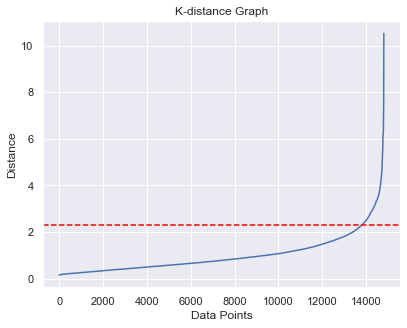

In [87]:
# K-distance graph to find out the right eps value
neigh = NearestNeighbors(n_neighbors=20)
neigh.fit(data[metric_features])
distances, _ = neigh.kneighbors(data[metric_features])
distances = np.sort(distances[:, -1])

# Plot the K-distance graph
plt.plot(distances)
plt.title('K-distance Graph')
plt.xlabel('Data Points')
plt.ylabel('Distance')
plt.grid(True)
plt.axhline(y=bandwidth, color='red', linestyle='--')
plt.show()

In [88]:
dbscan = DBSCAN(eps=bandwidth, min_samples=40)
dbscan_labels = dbscan.fit_predict(data[metric_features])

dbscan_n_clusters = len(np.unique(dbscan_labels))
print("Number of estimated clusters : %d" % dbscan_n_clusters)

Counter(dbscan_labels)

Number of estimated clusters : 4


Counter({0: 13084, 1: 915, -1: 698, 2: 109})

In [89]:
# Concatenating the labels to df
data_db_concat = pd.concat([data, pd.Series(dbscan_labels, index=data.index, name="dbscan_labels")], axis=1)

# Computing the R^2 of the cluster solution
data_db_nonoise = data_db_concat.loc[data_db_concat['dbscan_labels'] != -1]

sst_dbs = get_ss(data) 
ssw_labels_dbs = data_db_nonoise.groupby(by='dbscan_labels').apply(get_ss)  # compute ssw for each cluster labels
ssb_dbs = sst_dbs - np.sum(ssw_labels_dbs)  # remember: SST = SSW + SSB
r2_dbscore = ssb_dbs / sst_dbs

print("Cluster solution with R² of %0.4f (no noise)." % r2_dbscore)

Cluster solution with R² of 0.3313 (no noise).


- it seems like it is not good as a cluter technique, because the R^2 is low, and it is just showing a big cluster without separation.

Parameters: 2 None True 25 0.25 0.1 4 2 0.25


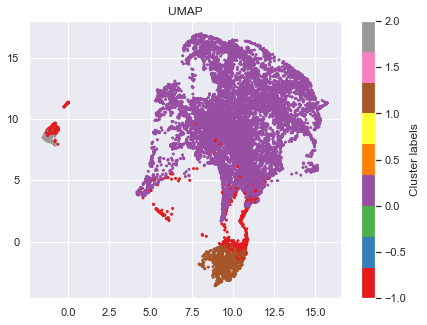

In [90]:
features = data_db_concat.drop(columns=['dbscan_labels'])

n_comp = [4]
repulsion = [2]
dist = [0.25] 
lr = [0.1]
target_weight = [0.25]
neighb = [25]
force_approx = [True]
n_epochs=[None]
spread=[2]

plot_umap(features, data_db_concat, 'dbscan_labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

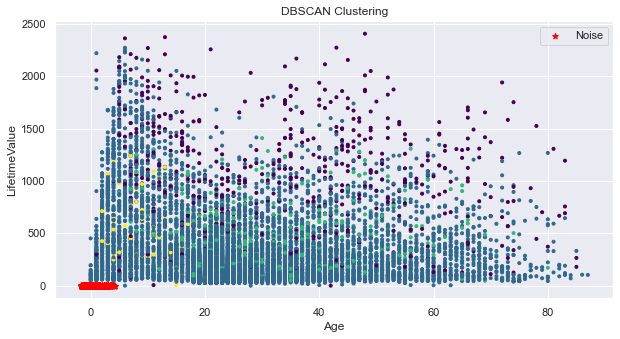

In [91]:
# Plotting the DBSCAN Clustering 
plt.figure(figsize=(10, 5))
plt.scatter(data_preprocessed.iloc[:, 0], data_preprocessed.iloc[:, 2], c=[dbscan_labels], cmap='viridis', marker='.')

# Marking noise points identified by DBSCAN
plt.scatter(data.iloc[dbscan_labels == -1, 0], data.iloc[dbscan_labels == -1, 1], c='red', marker='*', label='Noise')

# Formatting the plot
plt.title("DBSCAN Clustering")
plt.xlabel(data.columns.to_list()[0])
plt.ylabel(data.columns.to_list()[2])
plt.legend()
plt.show()

<hr>
<a class="anchor" id="km">

## 7.2. Kmeans Clustering
    
</a>

#### Let's perform the tests for the different clustering methods that we know.
We will calculate the r_squared from 2 to the total of 10 clusters, for every method and then evaluate what is the optimal algorithm.

In [92]:
# Obtaining the R² scores for each cluster solution
r2_scores_all = {}
r2_scores_all['kmeans'] = get_r2_scores(df_metric, kmeans)

#for linkage in ['complete', 'average', 'single', 'ward']:
#    r2_scores_all[linkage] = get_r2_scores(df_metric, hierarchical.set_params(linkage=linkage))

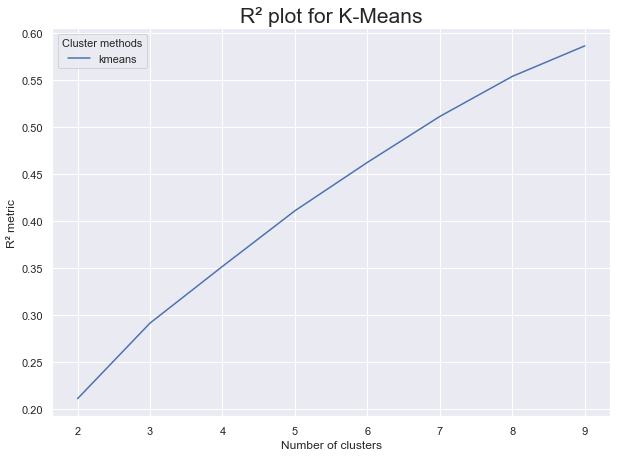

In [93]:
# Visualizing the R² scores for each cluster solution
pd.DataFrame(r2_scores_all).plot.line(figsize=(10,7))

plt.title("R² plot for K-Means", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters")
plt.ylabel("R² metric")
plt.show()

- Kmeans seems to get the highest R2 score. However, there is no clear evidence of where is the elbow of the curve. For this reason, we will plot the sillhouette scores for the possible solutions.

In [94]:
range_clusters = range(1, 10)

For n_clusters = 2, the average silhouette_score is : 0.40563963955556837
For n_clusters = 3, the average silhouette_score is : 0.22307548045593623
For n_clusters = 4, the average silhouette_score is : 0.24263189922088244
For n_clusters = 5, the average silhouette_score is : 0.25397692064531174
For n_clusters = 6, the average silhouette_score is : 0.24164331489623989
For n_clusters = 7, the average silhouette_score is : 0.20023610717149312
For n_clusters = 8, the average silhouette_score is : 0.21397359956181242
For n_clusters = 9, the average silhouette_score is : 0.21793543362214077


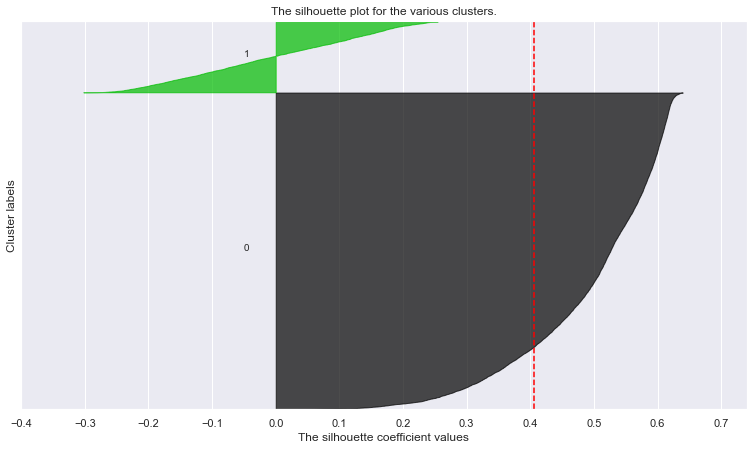

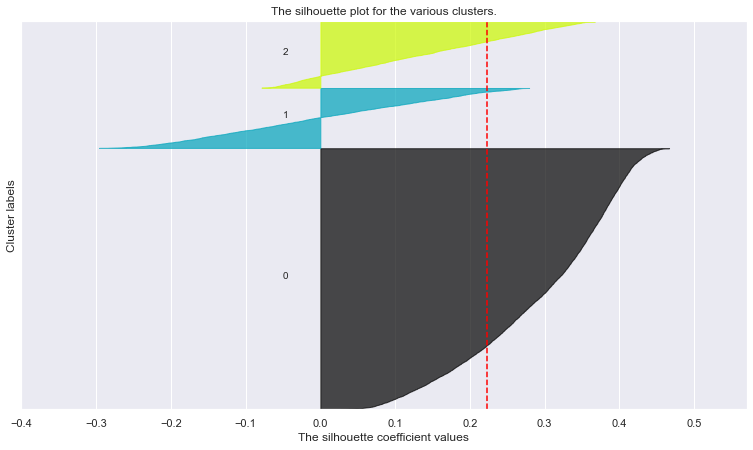

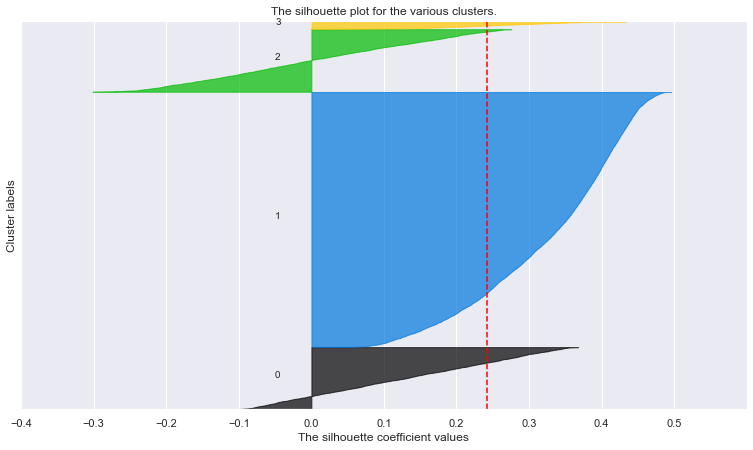

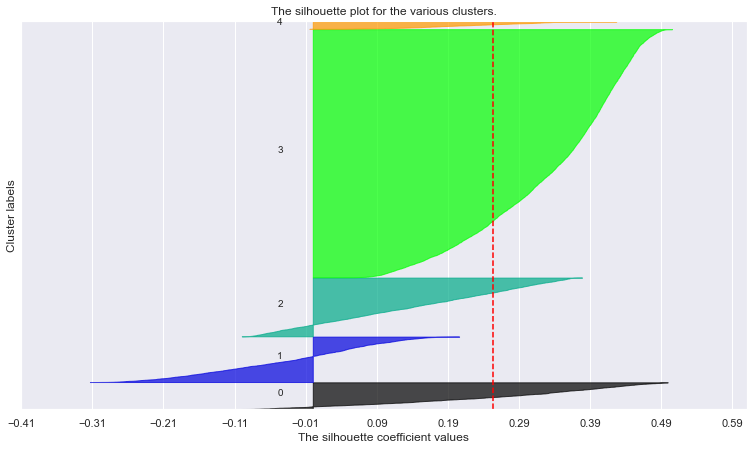

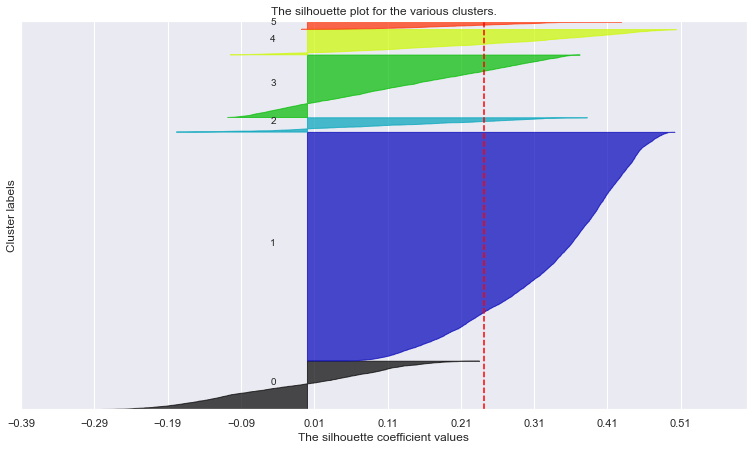

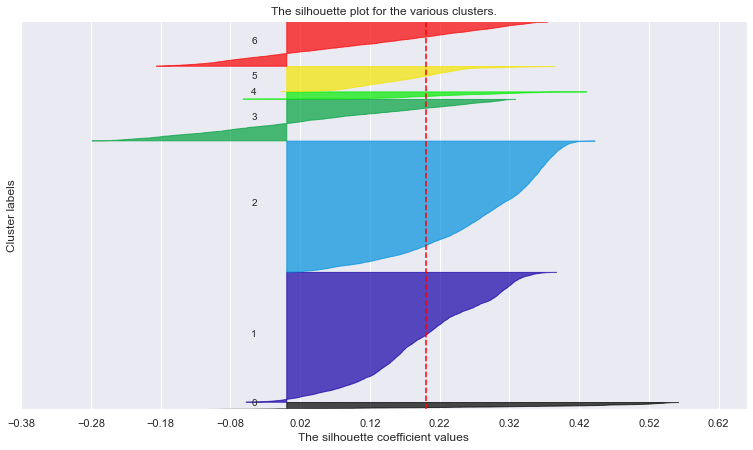

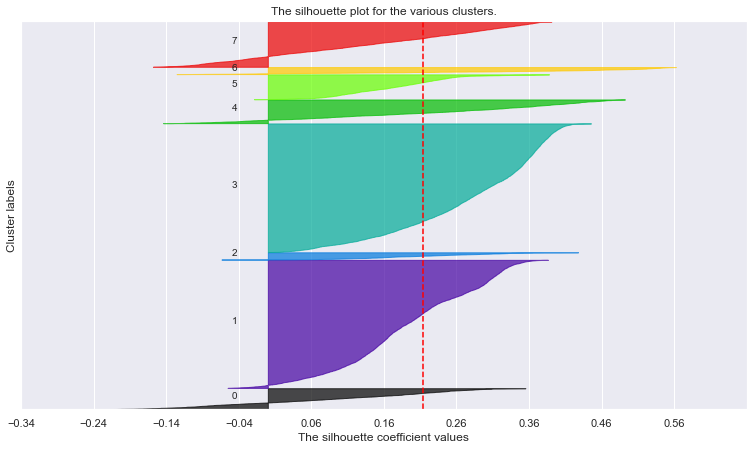

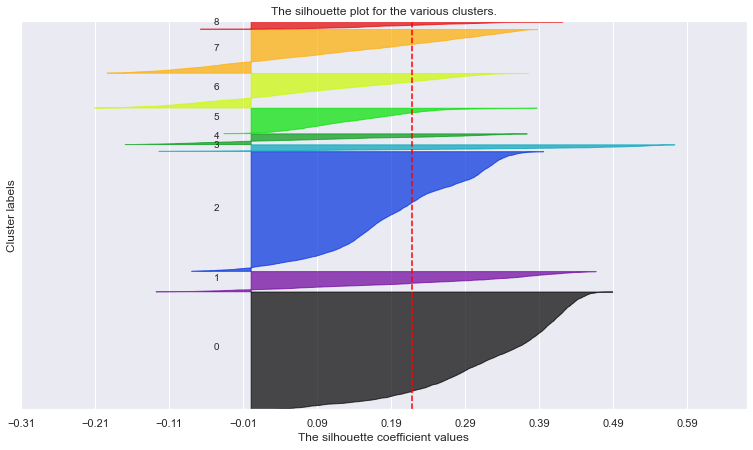

In [95]:
# Storing average silhouette metric
avg_silhouette = []
inertia_km = []
for nclus in range_clusters:
    kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)    
    cluster_labels = kmclust.fit_predict(data[metric_features])
    inertia_km.append(kmclust.inertia_)

    if nclus == 1:
        continue
    fig = plt.figure(figsize=(13, 7))
    
    silhouette_avg = silhouette_score(data[metric_features], cluster_labels)
    avg_silhouette.append(silhouette_avg)
    print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")

    sample_silhouette_values = silhouette_samples(data[metric_features], cluster_labels)

    y_lower = 10
    for i in range(nclus):
        # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        ith_cluster_silhouette_values.sort()
        
        # Get y_upper to demarcate silhouette y range size
        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i
        
        # Filling the silhouette
        color = cm.nipy_spectral(float(i) / nclus)
        plt.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # labels the silhouette plots with their cluster numbers at the middle
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    plt.title("The silhouette plot for the various clusters.")
    plt.xlabel("The silhouette coefficient values")
    plt.ylabel("Cluster labels")

    plt.axvline(x=silhouette_avg, color="red", linestyle="--")
    
    # The silhouette coefficient can range from -1, 1
    xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
    plt.xlim([xmin, xmax])
    plt.ylim([0, len(data[metric_features]) + (nclus + 1) * 10])
    plt.yticks([])
    plt.xticks(np.arange(xmin, xmax, 0.1))

When the average silhouette scores aren't changing significantly, it could indicate that the structure of data doesn't distinctly favor any particlar number of clusters. It can occur due to the homogeneous data or the overlaping clusters

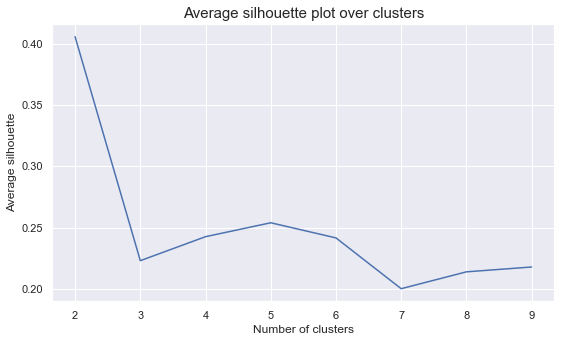

In [96]:
# the average silhouette score plot
plt.figure(figsize=(9,5))
plt.plot(range(2,10), avg_silhouette)
plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

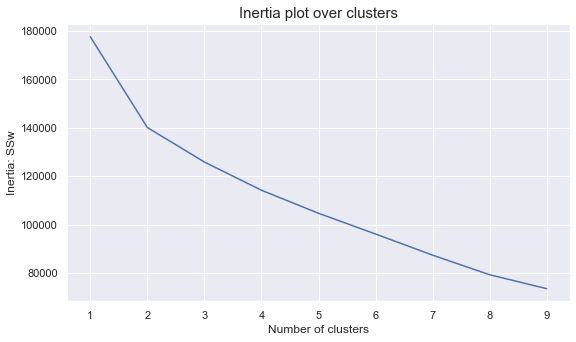

In [97]:
# The inertia plot
plt.figure(figsize=(9,5))
plt.plot(range_clusters, inertia_km)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

### Final KMeans clustering solution

In [98]:
number_clusters = 5
kmclust_opt = KMeans(n_clusters=number_clusters, init='k-means++', n_init=25, random_state=1)
km_labels_opt = kmclust_opt.fit_predict(data[metric_features])

Counter(km_labels_opt)

Counter({0: 9165, 1: 2202, 3: 2027, 2: 1130, 4: 282})

In [99]:
data_final_km = pd.concat((data, pd.Series(km_labels_opt, name='labels', index=data.index)), axis=1)
data_final_km.groupby('labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities
labels,,,,,,,,,,,,,,,,,,,,
0,-0.107802,-0.034031,-0.396094,0.031315,0.244190,0.573159,0.050409,0.116530,0.012657,-0.397471,-0.230911,-0.037047,-0.335885,-0.425496,-0.130989,0.366394,-0.456966,0.086634,-0.322398,-0.185217
1,0.380366,-0.422769,-0.234974,0.043597,0.183015,0.758856,0.012716,0.042234,0.042688,0.341924,-0.257447,0.415533,1.423045,-0.421842,-0.130989,0.458674,-0.389823,0.154405,1.649560,-0.100496
2,-0.263609,-0.379675,2.421585,0.049558,0.711504,0.255752,0.077876,0.049558,0.054867,1.998457,2.232909,-0.545795,0.432876,1.613496,-0.125625,0.476106,1.753615,0.600000,0.375697,0.270096
3,0.315288,0.796316,0.483778,0.121855,0.333004,0.633942,0.104588,0.172176,0.054267,0.239910,-0.123402,0.133000,-0.221963,1.326833,-0.130989,0.455846,1.347775,0.238283,-0.500589,0.757584
4,-0.676505,0.204723,1.526965,0.031915,0.751773,0.177305,0.095745,0.085106,0.003546,0.515426,1.454418,-0.809600,-0.334705,1.119939,6.724884,0.400709,1.180706,0.237589,-0.309920,0.276516


Parameters: 1.0 None True 50 0.5 0.1 3 2 0.75


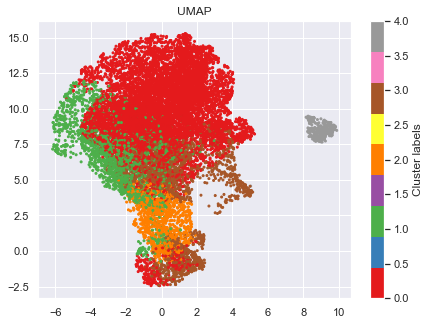

In [100]:
features = data_final_km[metric_features + ['labels']].drop(columns=['labels'])

n_comp = [3] # < 10
repulsion = [2]
dist = [0.75] #between 0 and 1
lr = [0.1]
target_weight = [0.5]
neighb = [50]
force_approx = [True]
n_epochs=[None]
spread=[1.0]

plot_umap(features, data_final_km[metric_features+['labels']], 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

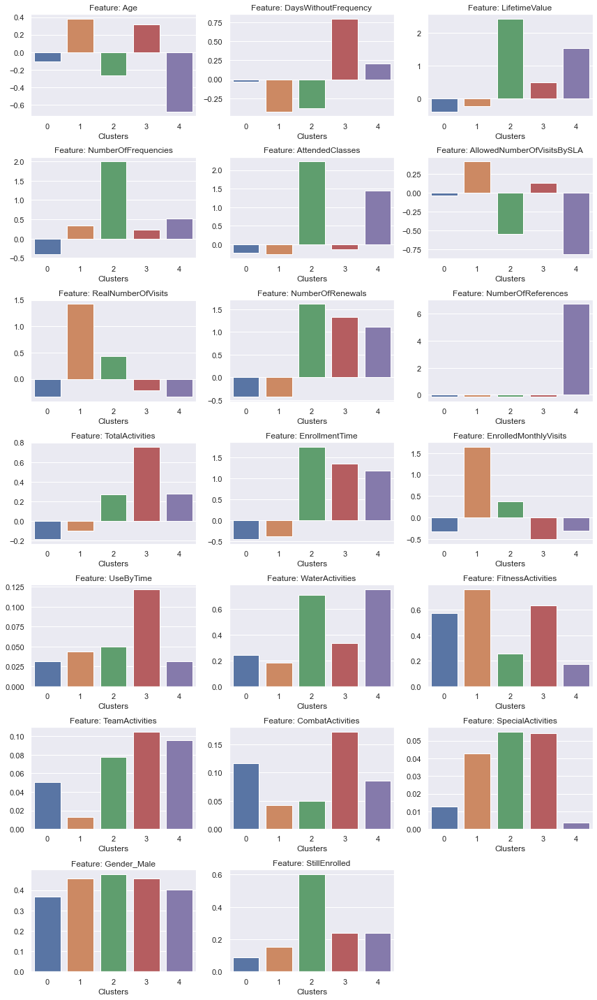

In [101]:
profiling(data_final_km, 'labels')

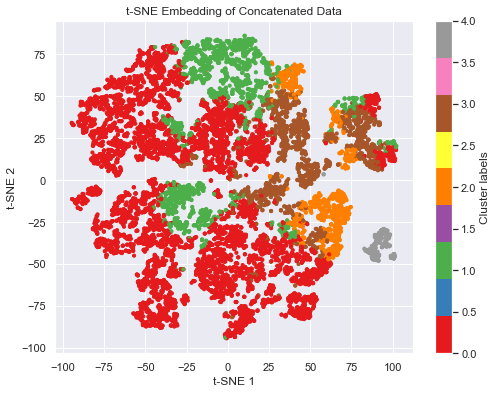

In [102]:
features = data_final_km.drop(columns=['labels'])
plot_tsne(features[metric_features], data_final_km, 'labels')

<hr>
<a class="anchor" id="kmedoids">

## 7.3. K-Medoids Clustering
    
</a>

In [103]:
num_samples_to_select = 2500
total_samples = len(data)
random_indices = np.random.choice(total_samples, size=num_samples_to_select, replace=False)
random_selected_data = data.iloc[random_indices]

avg_silhouette_kmedoids = []
inertia_kmedoids = []
for nclus in range_clusters:
    kmclust = KMedoids(n_clusters=nclus, random_state=43)    
    cluster_labels = kmclust.fit_predict(random_selected_data[metric_features + binary_features])
    inertia_kmedoids.append(kmclust.inertia_)
    if nclus == 1:
        continue
    avg_silhouette_kmedoids.append(silhouette_score(random_selected_data[metric_features + binary_features], cluster_labels))

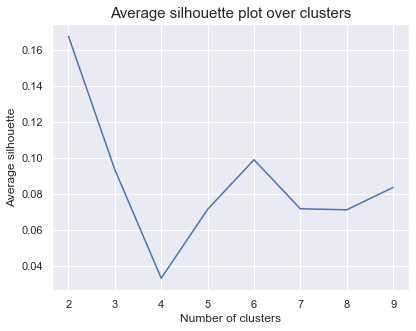

In [104]:
# the average silhouette score plot
plt.plot(range(2,10), avg_silhouette_kmedoids)
plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

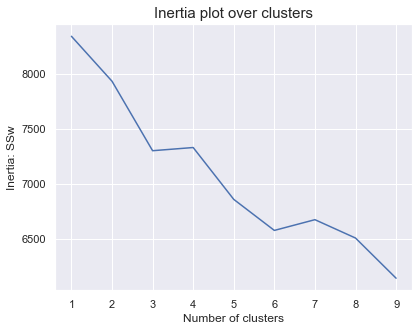

In [105]:
# The inertia plot
plt.plot(range_clusters, inertia_kmedoids)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

number_clusters = 4
kmedoids_clust_opt = KMedoids(n_clusters=number_clusters, random_state=1)
kmedoids_labels_opt = kmedoids_clust_opt.fit_predict(data[metric_features + binary_features])

Counter(kmedoids_labels_opt)

In [107]:
data_final_kmedoids = pd.concat((data, pd.Series(kmedoids_labels_opt, name='labels', index=data.index)), axis=1)
data_final_kmedoids.groupby('labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities
labels,,,,,,,,,,,,,,,,,,,,
0,0.109721,-0.078531,-0.435163,0.034996,0.166943,0.650272,0.014424,0.206668,0.005675,-0.408587,-0.363590,0.946784,-0.438602,-0.522131,-0.108059,0.373374,-0.486960,0.040908,-0.338270,-0.101097
1,0.412846,-0.406383,-0.180400,0.043034,0.169578,0.775884,0.013634,0.052833,0.044738,0.426945,-0.302035,0.560109,1.338981,-0.386057,-0.094836,0.454623,-0.333143,0.147422,1.600358,-0.056553
2,-0.183746,-0.091694,1.585790,0.078505,0.618692,0.325981,0.100187,0.092336,0.045234,1.052699,1.225862,-0.417577,0.070521,1.538485,0.265504,0.468037,1.627919,0.455701,-0.094258,0.374391
3,-0.169476,0.275638,-0.356127,0.042484,0.283168,0.558956,0.082088,0.062106,0.023942,-0.376254,-0.185902,-0.756347,-0.265776,-0.180248,-0.005520,0.368137,-0.272448,0.112331,-0.373241,-0.079429


In [108]:
#isto n faz sentido pq tamos so a por as metrics
# sst = get_ss(data_final_kmedoids[metric_features])  # get total sum of squares
# ssw_labels = data_final_kmedoids[metric_features + ["labels"]].groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
# ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
# r2 = ssb / sst
# r2

features = data_final_kmedoids.drop(columns=['labels'])

n_comp = [2] # < 10
repulsion = [2]
dist = [0.75] #between 0 and 1
lr = [0.1]
target_weight = [0.5]
neighb = [50]
force_approx = [True]
n_epochs=[None]
spread=[1.0]

plot_umap(features, data_final_kmedoids, 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

<hr>
<a class="anchor" id="kprototypes">

## 7.4. K-Prototypes Clustering
    
</a>

In [110]:
#<hr>
#<a class="anchor" id="km">

## 7.2. Kmeans Clustering
    
#</a>

binary_indices = [data.columns.get_loc(col) for col in binary_features]
binary_indices

[3, 4, 5, 6, 7, 8, 15, 17]

 - the next 3 boxes take a lot of time to run

avg_silhouette_kprototypes = []
inertia_kprototypes = []

for nclus in range_clusters:
    kmclust = KPrototypes(n_clusters=nclus, init='Cao', random_state=42)
    cluster_labels = kmclust.fit_predict(data, categorical=binary_indices)
    #inertia_kprototypes.append(kmclust.inertia_)
    if nclus == 1:
        continue
    
    # Calculate silhouette score for the clustering result
    silhouette_avg = silhouette_score(data, cluster_labels)
    avg_silhouette_kprototypes.append(silhouette_avg)

 the average silhouette score plot
plt.plot(range(2,11), avg_silhouette_kprototypes)
plt.ylabel("Average silhouette")
plt.xlabel("Number of clusters")
plt.title("Average silhouette plot over clusters", size=15)
plt.show()

 The inertia plot
plt.plot(range_clusters, inertia_kprototypes)
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

##### For 3 clusters

In [111]:
number_clusters = 3
kprototypes_clust_opt = KPrototypes(n_clusters=number_clusters, init='Cao', random_state=42)
kprototypes_labels_opt = kprototypes_clust_opt.fit_predict(data, categorical=binary_indices)

Counter(kprototypes_labels_opt)

Counter({2: 9987, 0: 2563, 1: 2256})

In [112]:
data_final_kprototypes = pd.concat((data, pd.Series(kprototypes_labels_opt, name='labels', index=data.index)), axis=1)
data_final_kprototypes.groupby('labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities
labels,,,,,,,,,,,,,,,,,,,,
0,0.365612,-0.410815,-0.226639,0.04565,0.182989,0.759657,0.011705,0.046430,0.040187,0.322961,-0.247343,0.406648,1.311570,-0.399752,-0.102612,0.451424,-0.364235,0.157628,1.512770,-0.088491
1,-0.094212,0.023341,1.825727,0.08555,0.614805,0.363032,0.104610,0.098404,0.057624,1.319866,1.339027,-0.362933,0.125994,1.696117,0.379441,0.469858,1.811515,0.459663,-0.000686,0.558396
2,-0.072546,0.100156,-0.354257,0.03855,0.247922,0.578953,0.055172,0.125063,0.015020,-0.381032,-0.239001,-0.022375,-0.365054,-0.280552,-0.059379,0.373085,-0.315735,0.092220,-0.388073,-0.103428


dfeatures = data_final_kprototypes.drop(columns=['labels'])

n_comp = [2] # < 10
repulsion = [2]
dist = [0.75] #between 0 and 1
lr = [0.1]
target_weight = [0.5]
neighb = [50]
force_approx = [True]
n_epochs=[None]
spread=[1.0]

plot_umap(features, data_final_kprototypes, 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

#### For 4 clusters

In [114]:
number_clusters = 4
kprototypes_clust_opt2 = KPrototypes(n_clusters=number_clusters, init='Cao', random_state=42)
kprototypes_labels_opt2 = kprototypes_clust_opt.fit_predict(data, categorical=binary_indices)

Counter(kprototypes_labels_opt)

Counter({2: 9987, 0: 2563, 1: 2256})

In [115]:
data_final_kprototypes2 = pd.concat((data, pd.Series(kprototypes_labels_opt2, name='labels', index=data.index)), axis=1)
data_final_kprototypes2.groupby('labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities
labels,,,,,,,,,,,,,,,,,,,,
0,0.365612,-0.410815,-0.226639,0.04565,0.182989,0.759657,0.011705,0.046430,0.040187,0.322961,-0.247343,0.406648,1.311570,-0.399752,-0.102612,0.451424,-0.364235,0.157628,1.512770,-0.088491
1,-0.094212,0.023341,1.825727,0.08555,0.614805,0.363032,0.104610,0.098404,0.057624,1.319866,1.339027,-0.362933,0.125994,1.696117,0.379441,0.469858,1.811515,0.459663,-0.000686,0.558396
2,-0.072546,0.100156,-0.354257,0.03855,0.247922,0.578953,0.055172,0.125063,0.015020,-0.381032,-0.239001,-0.022375,-0.365054,-0.280552,-0.059379,0.373085,-0.315735,0.092220,-0.388073,-0.103428


Parameters: 1.0 None True 50 0.5 0.1 2 2 0.75


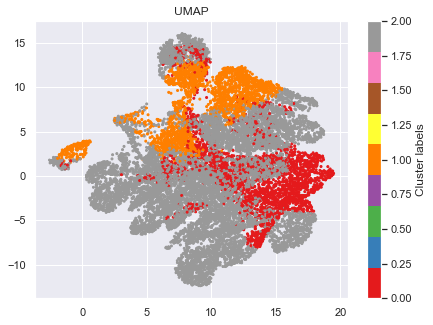

In [116]:
features = data_final_kprototypes2.drop(columns=['labels'])

n_comp = [2] # < 10
repulsion = [2]
dist = [0.75] #between 0 and 1
lr = [0.1]
target_weight = [0.5]
neighb = [50]
force_approx = [True]
n_epochs=[None]
spread=[1.0]

plot_umap(features, data_final_kprototypes2, 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

<hr>
<a class="anchor" id="som">

## 7.5. Self-Organizing Maps
    
</a>

In [117]:
# This som implementation does not have a random seed parameter
# We're going to set it up ourselves
np.random.seed(42)

# Notice that the SOM did not converge - We're under a time constraint for this class
sm = sompy.SOMFactory().build(
    data[metric_features].values, 
    mapsize=[50, 50], initialization='random',
    neighborhood='gaussian', training='batch',
    lattice='hexa', component_names=metric_features
)

sm.train(n_job=-1, verbose='info', train_rough_len=30, train_finetune_len=30)

 Training...
 random_initialization took: 0.016000 seconds
 Rough training...
 radius_ini: 17.000000 , radius_final: 2.833333, trainlen: 30

 epoch: 1 ---> elapsed time:  0.535000, quantization error: 5.938464

 epoch: 2 ---> elapsed time:  0.472000, quantization error: 2.958752

 epoch: 3 ---> elapsed time:  0.455000, quantization error: 2.933979

 epoch: 4 ---> elapsed time:  0.471000, quantization error: 2.921340

 epoch: 5 ---> elapsed time:  0.455000, quantization error: 2.911754

 epoch: 6 ---> elapsed time:  0.503000, quantization error: 2.902597

 epoch: 7 ---> elapsed time:  0.519000, quantization error: 2.894283

 epoch: 8 ---> elapsed time:  0.635000, quantization error: 2.887040

 epoch: 9 ---> elapsed time:  0.482000, quantization error: 2.879618

 epoch: 10 ---> elapsed time:  0.471000, quantization error: 2.871951

 epoch: 11 ---> elapsed time:  0.519000, quantization error: 2.863982

 epoch: 12 ---> elapsed time:  0.471000, quantization error: 2.855690

 epoch: 13 ---> 

<hr>
<a class="anchor" id="kmeans_som">

## 7.5.1. SOM Clustering: K-means on top of SOM units
    
</a>

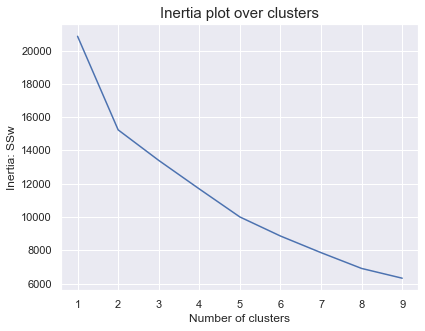

In [118]:
range_clusters = range(1,10)

inertia_km = []
for n_clus in range_clusters:
    kmclust = KMeans(n_clusters = n_clus, n_init = 15, init = "k-means++", random_state = 1)
    # fit the clusterer
    kmclust.fit(sm.codebook.matrix)
    inertia_km.append(kmclust.inertia_) 


plt.plot(range_clusters,inertia_km) 
plt.ylabel("Inertia: SSw")
plt.xlabel("Number of clusters")
plt.title("Inertia plot over clusters", size=15)
plt.show()

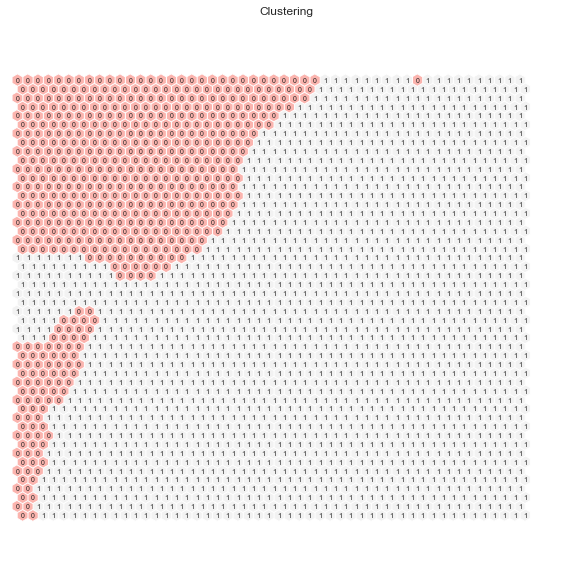

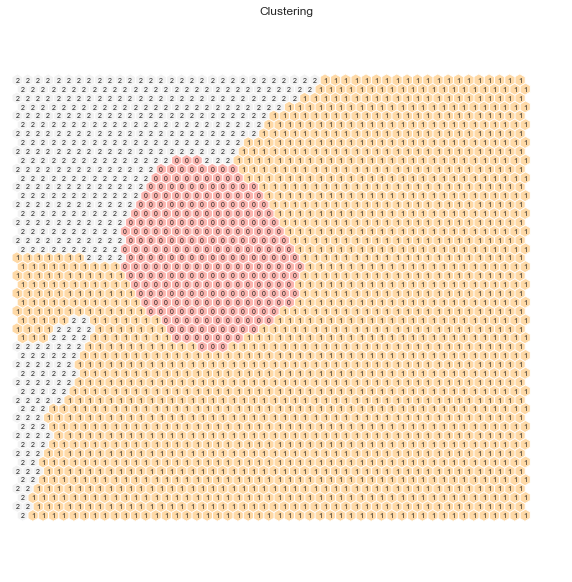

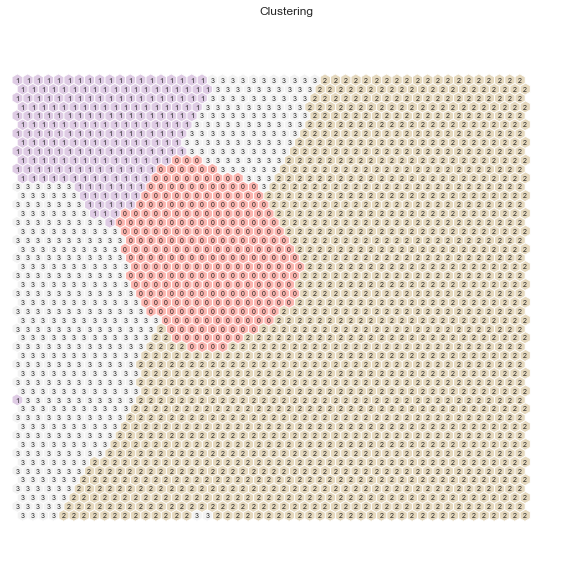

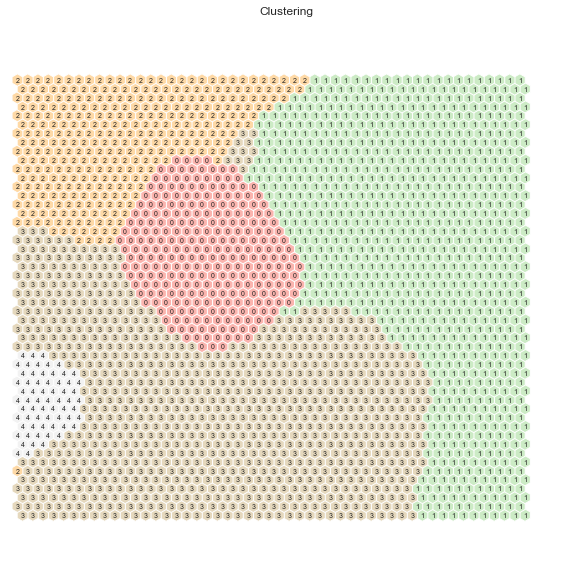

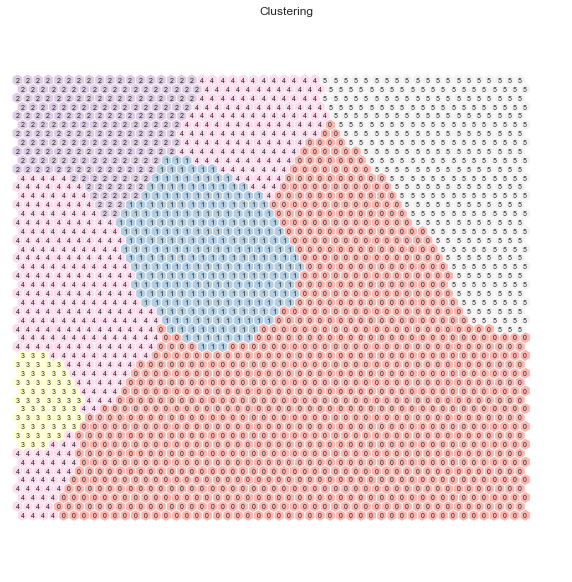

In [119]:
for nclus in range(2,7):
    # (sm.get_node_vectors() output)
    kmeans = KMeans(n_clusters=nclus, init='k-means++', n_init=20, random_state=42)
    nodeclus_labels = kmeans.fit_predict(sm.codebook.matrix)
    sm.cluster_labels = nodeclus_labels
    
    hits = HitMapView(10,10,"Clustering", text_size=10)
    hits.show(sm, anotate=True, onlyzeros=False, cmap="Pastel1")
    plt.show()

In [120]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

kmeans = KMeans(n_clusters=5, random_state=42, n_init=25)
nodeclus_labels = kmeans.fit_predict(sm.codebook.matrix)
#sm.cluster_labels = nodeclus_labels

df_nodes = pd.DataFrame(nodes, columns=metric_features)
df_nodes['labels'] = nodeclus_labels
Counter(df_nodes.labels)

Counter({3: 923, 1: 902, 2: 334, 0: 278, 4: 63})

In [121]:
# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(data[metric_features])[0]  # get bmus for each observation in df

df_bmus = pd.DataFrame(
    np.concatenate((data, np.expand_dims(bmus_map,1)), axis=1),
    index=data.index, columns=np.append(data.columns,"BMU")
)
df_bmus  # best matching units

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities,BMU
ID,,,,,,,,,,,,,,,,,,,,,
10000,2.408720,-0.586625,-0.604100,0.0,0.0,1.0,0.0,0.0,0.0,-0.502232,-0.093552,-1.799493,-0.534385,-0.871919,-0.130989,0.0,-0.860920,0.0,0.583622,-0.279073,1564.0
10001,0.213633,-0.145745,0.540339,0.0,0.0,0.0,0.0,0.0,1.0,-0.263664,-0.334928,-1.239360,-0.699517,0.598510,-0.130989,0.0,-0.057275,0.0,-0.484416,-0.279073,1739.0
10002,-0.211223,-0.541790,-0.756017,0.0,0.0,1.0,0.0,0.0,0.0,-0.553353,-0.375157,-0.577384,0.126141,-0.871919,-0.130989,1.0,-0.927103,0.0,1.075262,-0.279073,2469.0
10003,-1.202552,-0.429702,-0.410205,0.0,0.0,0.0,1.0,0.0,0.0,-0.314786,-0.294698,-1.188439,-0.369254,-0.871919,-0.130989,1.0,-0.619827,0.0,0.252711,-0.279073,2373.0
10004,0.638488,0.975137,0.229166,0.0,0.0,1.0,0.0,0.0,0.0,0.043065,-0.375157,1.001173,-0.864648,1.333725,-0.130989,1.0,0.840917,0.0,-0.540237,-0.279073,374.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24937,-0.848506,-0.579153,3.420885,0.0,1.0,0.0,0.0,0.0,0.0,1.252942,3.486852,-0.322778,0.456404,1.333725,-0.130989,1.0,1.715472,1.0,-0.048223,-0.279073,347.0
24938,0.921725,-0.310141,0.143007,0.0,0.0,0.0,0.0,1.0,0.0,0.315713,-0.375157,1.001173,-0.369254,-0.871919,-0.130989,1.0,-0.381097,0.0,1.276961,-0.279073,1100.0
24939,-0.423650,-0.579153,-0.738404,0.0,0.0,1.0,0.0,0.0,0.0,-0.553353,-0.375157,-0.577384,0.456404,-0.871919,-0.130989,1.0,-0.927103,0.0,1.075262,-0.279073,2469.0


In [122]:
# Get cluster labels for each observation
df_somkm_final = df_bmus.merge(df_nodes['labels'], 'left', left_on="BMU", right_index=True)

data_preprocessed['BMU'] = df_bmus["BMU"]
data_preprocessed.merge(df_nodes['labels'], 'left', left_on="BMU", right_index=True).drop(columns='BMU').groupby('labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities
labels,,,,,,,,,,,,,,,,,,,,
0,28.182807,67.591948,314.571839,0.075082,0.496192,0.799782,0.137106,0.426551,0.134929,35.344940,4.752992,42.806311,4.310120,1.638738,0.000000,0.450490,557.106638,0.190424,2.481318,2.094668
1,29.340583,50.899629,168.334226,0.039472,0.145642,0.691155,0.012728,0.127598,0.014500,28.852747,0.547769,56.782665,6.314161,0.566457,0.000000,0.400354,241.758660,0.077815,3.980355,1.000967
2,27.904181,53.598142,943.826458,0.101626,0.520325,0.412892,0.076074,0.070848,0.056330,136.642857,42.079559,38.110918,7.153310,3.540650,0.000581,0.476190,1211.120209,0.487224,3.574409,1.155052
3,21.854853,119.401797,208.028150,0.034701,0.328342,0.486701,0.079972,0.045799,0.012507,18.220011,7.930069,25.980624,3.725912,1.000528,0.000176,0.371851,333.801304,0.140743,2.029903,1.002642
4,16.249110,103.010676,817.023381,0.032028,0.754448,0.174377,0.096085,0.085409,0.003559,68.765125,45.640569,25.459075,3.213523,2.704626,1.131673,0.402135,919.722420,0.234875,2.214847,1.181495


In [123]:
data_preprocessed=data_preprocessed.drop(["BMU"], axis=1)

In [124]:
Counter(df_somkm_final.labels)

Counter({1: 6207, 3: 5677, 2: 1722, 0: 919, 4: 281})

In [125]:
sst = get_ss(df_somkm_final[metric_features])  # get total sum of squares
ssw_labels = df_somkm_final[metric_features + ["labels"]].groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
r2

0.3809094128470299

Parameters: 0.1 None True 25 0.25 0.1 4 2 0.1


c:\ProgramData\anaconda3\Lib\site-packages\umap\umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
C:\Users\duart\AppData\Roaming\Python\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


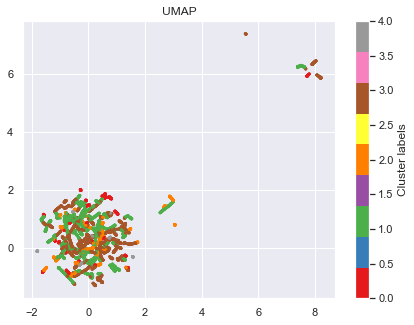

In [126]:
features = df_somkm_final.drop(columns=['labels'])

n_comp = [4] # < 10
repulsion = [2]
dist = [0.1] #between 0 and 1
lr = [0.1]
target_weight = [0.25]
neighb = [25]
force_approx = [True]
n_epochs=[None]
spread=[0.1]

plot_umap(features, df_somkm_final, 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

<hr>
<a class="anchor" id="hc_som">

## 7.5.2. SOM Clustering: Hierarchical Clustering on top of SOM units
    
</a>

In [127]:
r2_hc_scores = {}

max_nclus = 10
for linkage in ['complete', 'average', 'single', 'ward']:
    r2_hc_scores[linkage] = get_r2_scores(pd.DataFrame(sm.codebook.matrix, columns=metric_features), hierarchical.set_params(linkage=linkage))
    print(linkage)

complete
average
single
ward


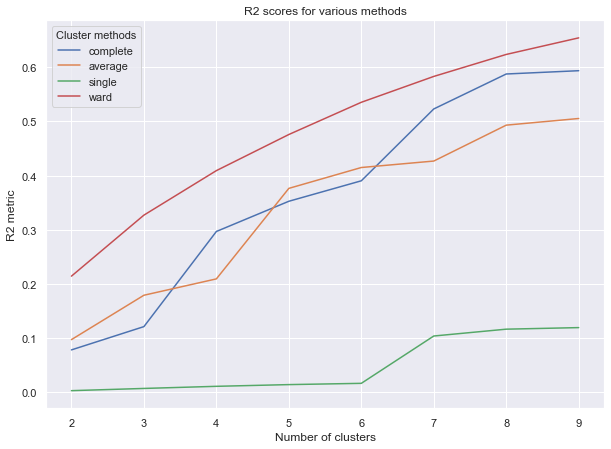

In [128]:
sns.set()
pd.DataFrame(r2_hc_scores).plot.line(figsize=(10,7))

plt.xlabel('Number of clusters')
plt.ylabel('R2 metric')
plt.title('R2 scores for various methods')
plt.legend(title="Cluster methods", title_fontsize=11)
plt.grid(True)
plt.show()

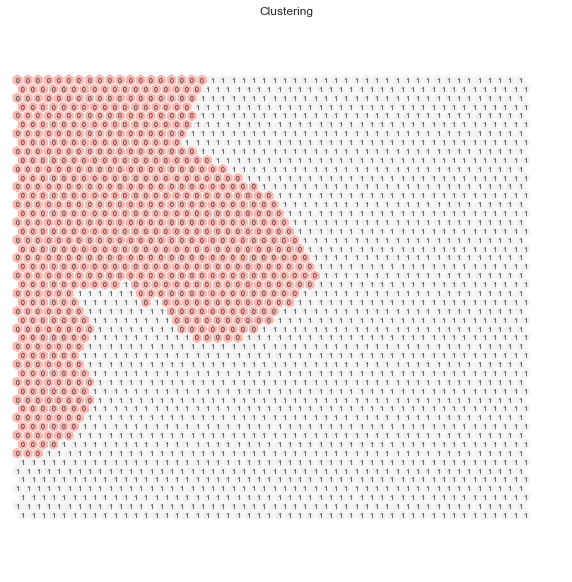

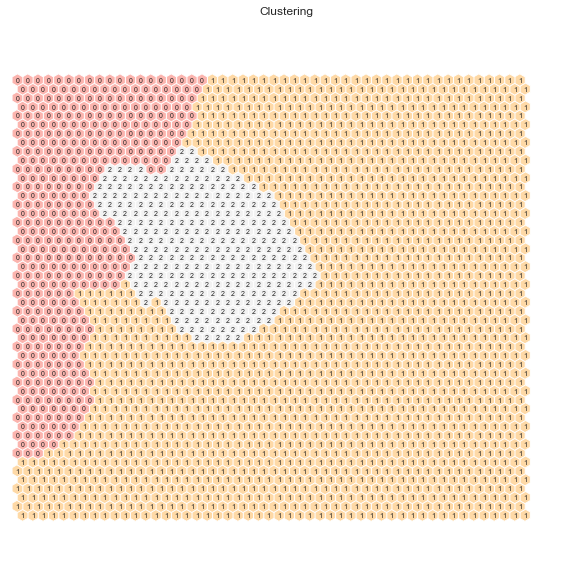

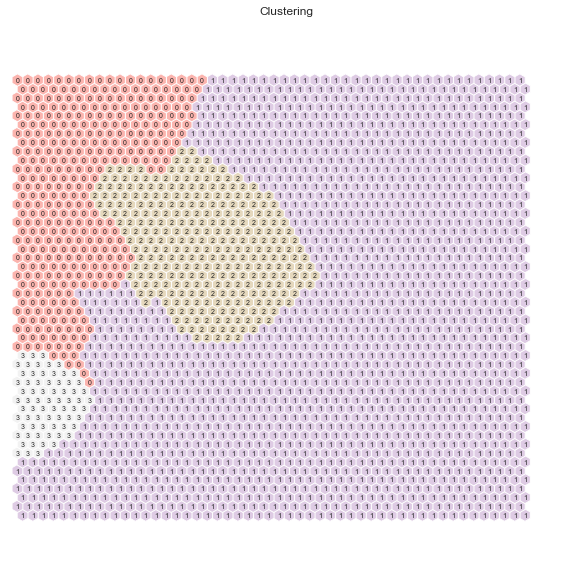

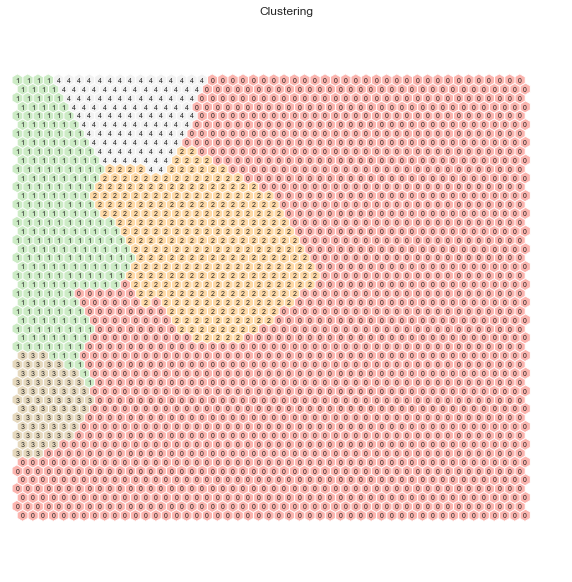

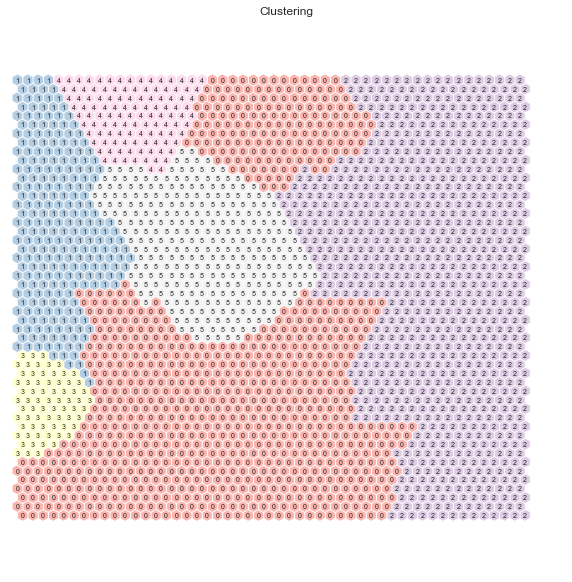

In [129]:
for nclus in range(2,7):
    # (sm.get_node_vectors() output)
    hierclust = AgglomerativeClustering(n_clusters=nclus, linkage='ward')
    nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
    sm.cluster_labels = nodeclus_labels
    
    hits = HitMapView(10,10,"Clustering", text_size=10)
    hits.show(sm, anotate=True, onlyzeros=False, cmap="Pastel1")
    plt.show()

### Final SOM Hierarchical Clustering solution

In [130]:
# Check the nodes and and respective clusters
nodes = sm.codebook.matrix

hierclust = AgglomerativeClustering(n_clusters=3, linkage='ward')
nodeclus_labels = hierclust.fit_predict(sm.codebook.matrix)
#sm.cluster_labels = nodeclus_labels

df_nodes = pd.DataFrame(nodes, columns=metric_features)
df_nodes['labels'] = nodeclus_labels
Counter(df_nodes.labels)

Counter({1: 1765, 0: 431, 2: 304})

Parameters: 0.1 None True 25 0.25 0.1 4 2 0.1


c:\ProgramData\anaconda3\Lib\site-packages\umap\umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


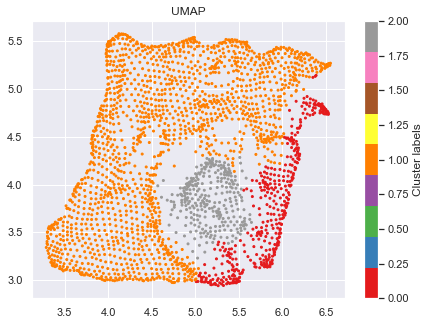

In [131]:
features = df_nodes.drop(columns=['labels'])

n_comp = [4] # < 10
repulsion = [2]
dist = [0.1] #between 0 and 1
lr = [0.1]
target_weight = [0.25]
neighb = [25]
force_approx = [True]
n_epochs=[None]
spread=[0.1]

plot_umap(features, df_nodes, 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

In [132]:
# Obtaining SOM's BMUs labels
bmus_map = sm.find_bmu(data[metric_features])[0]  # get bmus for each observation in df

df_bmus = pd.DataFrame(
    np.concatenate((data, np.expand_dims(bmus_map,1)), axis=1),
    index=data.index, columns=np.append(data.columns,"BMU")
)
df_bmus
# best matching units

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities,BMU
ID,,,,,,,,,,,,,,,,,,,,,
10000,2.408720,-0.586625,-0.604100,0.0,0.0,1.0,0.0,0.0,0.0,-0.502232,-0.093552,-1.799493,-0.534385,-0.871919,-0.130989,0.0,-0.860920,0.0,0.583622,-0.279073,1564.0
10001,0.213633,-0.145745,0.540339,0.0,0.0,0.0,0.0,0.0,1.0,-0.263664,-0.334928,-1.239360,-0.699517,0.598510,-0.130989,0.0,-0.057275,0.0,-0.484416,-0.279073,1739.0
10002,-0.211223,-0.541790,-0.756017,0.0,0.0,1.0,0.0,0.0,0.0,-0.553353,-0.375157,-0.577384,0.126141,-0.871919,-0.130989,1.0,-0.927103,0.0,1.075262,-0.279073,2469.0
10003,-1.202552,-0.429702,-0.410205,0.0,0.0,0.0,1.0,0.0,0.0,-0.314786,-0.294698,-1.188439,-0.369254,-0.871919,-0.130989,1.0,-0.619827,0.0,0.252711,-0.279073,2373.0
10004,0.638488,0.975137,0.229166,0.0,0.0,1.0,0.0,0.0,0.0,0.043065,-0.375157,1.001173,-0.864648,1.333725,-0.130989,1.0,0.840917,0.0,-0.540237,-0.279073,374.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24937,-0.848506,-0.579153,3.420885,0.0,1.0,0.0,0.0,0.0,0.0,1.252942,3.486852,-0.322778,0.456404,1.333725,-0.130989,1.0,1.715472,1.0,-0.048223,-0.279073,347.0
24938,0.921725,-0.310141,0.143007,0.0,0.0,0.0,0.0,1.0,0.0,0.315713,-0.375157,1.001173,-0.369254,-0.871919,-0.130989,1.0,-0.381097,0.0,1.276961,-0.279073,1100.0
24939,-0.423650,-0.579153,-0.738404,0.0,0.0,1.0,0.0,0.0,0.0,-0.553353,-0.375157,-0.577384,0.456404,-0.871919,-0.130989,1.0,-0.927103,0.0,1.075262,-0.279073,2469.0


In [133]:
# Get cluster labels for each observation
df_somhc_final = df_bmus.merge(df_nodes['labels'], 'left', left_on="BMU", right_index=True)
df_somhc_final.drop(columns='BMU').groupby('labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities
labels,,,,,,,,,,,,,,,,,,,,
0,-0.324424,-0.249338,1.641713,0.045475,0.680795,0.219868,0.075938,0.043267,0.040177,1.215573,1.487484,-0.655014,0.191172,1.185708,0.722590,0.448565,1.227410,0.459603,0.133582,0.016607
1,0.053066,0.056281,-0.345454,0.045076,0.195995,0.630895,0.041696,0.094053,0.013523,-0.242142,-0.294217,0.127554,-0.022687,-0.272581,-0.130463,0.387049,-0.280268,0.095787,-0.008688,-0.272415
2,0.122039,-0.084091,0.265355,0.071642,0.526368,0.768159,0.163184,0.404975,0.135323,0.039877,0.024814,0.012086,-0.170439,0.456588,-0.130989,0.459701,0.450837,0.214925,-0.201328,3.089517


In [134]:
Counter(df_somhc_final.labels)

Counter({1: 11536, 0: 2265, 2: 1005})

In [135]:
sst = get_ss(df_somhc_final[metric_features])  # get total sum of squares
ssw_labels = df_somhc_final[metric_features + ["labels"]].groupby(by='labels').apply(get_ss)  # compute ssw for each cluster labels
ssb = sst - np.sum(ssw_labels)  # remember: SST = SSW + SSB
r2 = ssb / sst
r2

0.22534273028808383

Parameters: 0.1 None True 25 0.25 0.1 4 2 0.1


c:\ProgramData\anaconda3\Lib\site-packages\umap\umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))
C:\Users\duart\AppData\Roaming\Python\Python311\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


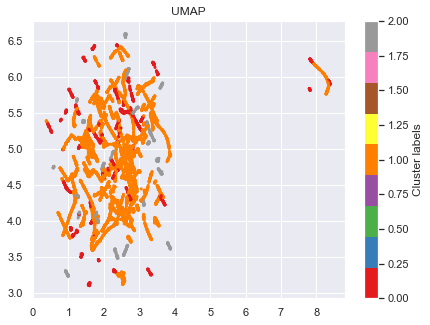

In [136]:
features = df_somhc_final.drop(columns=['labels'])

n_comp = [4] # < 10
repulsion = [2]
dist = [0.1] #between 0 and 1
lr = [0.1]
target_weight = [0.25]
neighb = [25]
force_approx = [True]
n_epochs=[None]
spread=[0.1]

plot_umap(features, df_somhc_final, 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

<hr>
<a class="anchor" id="segm">

## 8. Customer Segmentation
    
</a>


<a id='PVA'></a></b><br>
* [8.1. Demographic Analysis](#dem)
* [8.2. Product Behavorial Analysis](#prod_bhv)
* [8.3. Merging Perspectives](#merge)
* [8.4. Clustering Profile](#prof)

In [137]:
# Splitting and choosing variables acoording to each clustering segementation/perspetive

demographic_features = [
    'Age',
    'LifetimeValue', 
    #'Gender_Male'
]

product_behavioral_features = [
    'AttendedClasses',
    'DaysWithoutFrequency',
    'NumberOfFrequencies',
    'NumberOfRenewals',
    'EnrollmentTime',
    'TotalActivities',
    #'UseByTime',
    'RealNumberOfVisits',
    'EnrolledMonthlyVisits',
    'StillEnrolled',
    #'WaterActivities',
    #'FitnessActivities',
    #'TeamActivities',
    #'CombatActivities',
    #'SpecialActivities'
]

df_dem = data[demographic_features].copy()
df_prod_bhv = data[product_behavioral_features].copy()

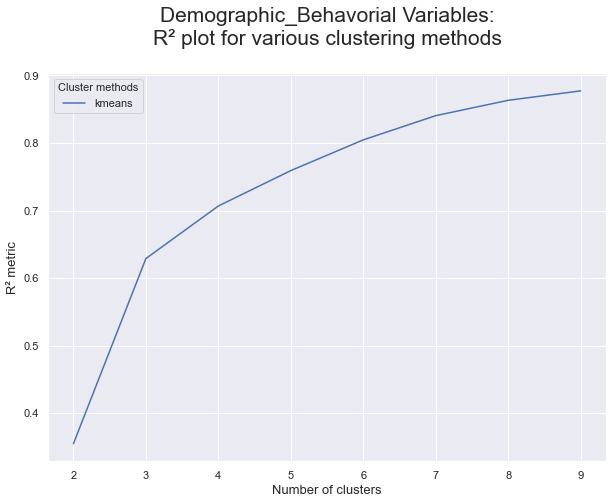

In [138]:
# Obtaining the R² scores for each cluster solution on demographic variables
r2_scores_dem = {}
r2_scores_dem['kmeans'] = get_r2_scores(df_dem, kmeans.set_params(n_init=10))

#for linkage in ['complete', 'average', 'single', 'ward']:
#    r2_scores_dem[linkage] = get_r2_scores(df_dem, hierarchical.set_params(linkage=linkage))
    
# Visualizing the R² scores for each cluster solution on demographic variables
pd.DataFrame(r2_scores_dem).plot.line(figsize=(10,7))

plt.title("Demographic_Behavorial Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

<hr>
<a class="anchor" id="dem">

## 8.1. Demographic Segmentation
    
</a>

In [139]:
np.random.seed(42)

# Perform K-Means clustering on top of the 2500 units (sm.get_node_vectors() output)
kmeans_dem = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=42)
km_labels_dem = kmeans_dem.fit_predict(df_dem)

df_concat_dem_km = pd.concat((df_dem, pd.Series(km_labels_dem, name='labels', index=df_dem.index)), axis=1)
pd.concat((data_preprocessed, pd.Series(km_labels_dem, name='labels', index=df_dem.index)), axis=1).groupby('labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities
labels,,,,,,,,,,,,,,,,,,,,
0,22.349593,82.946832,130.755987,0.041812,0.136663,0.734934,0.035230,0.121951,0.005420,21.221577,1.238740,45.218609,5.153052,0.716996,0.003097,0.375919,275.693638,0.074332,3.050529,1.061943
1,42.480118,62.005891,997.350133,0.123711,0.460972,0.577320,0.066274,0.110457,0.095729,171.300442,26.276878,45.776141,7.889543,3.382916,0.035346,0.493373,1183.011782,0.421208,4.448033,1.350515
2,37.366477,81.593344,223.365954,0.071429,0.286120,0.602679,0.029627,0.095779,0.037338,29.259740,4.605925,44.615666,5.148539,1.000000,0.008523,0.385552,346.065747,0.106737,3.152691,1.093750
3,10.398293,56.697013,1313.670711,0.017070,0.860597,0.056899,0.129445,0.081081,0.025605,116.667141,76.897582,25.059744,5.342817,3.687055,0.165007,0.479374,1260.499289,0.623044,2.850696,1.177809
4,10.771671,77.817248,423.644339,0.025022,0.642091,0.135836,0.146113,0.108579,0.010277,41.986148,18.050492,26.422699,4.361930,1.570152,0.054513,0.471850,532.827525,0.253798,2.366362,1.088919
5,60.827338,79.363823,264.482497,0.044193,0.218911,0.649538,0.008222,0.034943,0.146968,41.922919,4.960946,45.115108,6.201439,1.167523,0.013361,0.361768,391.200411,0.237410,3.659511,1.073998


In [140]:
Counter(km_labels_dem)

Counter({0: 7749, 2: 2464, 4: 2238, 5: 973, 3: 703, 1: 679})

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


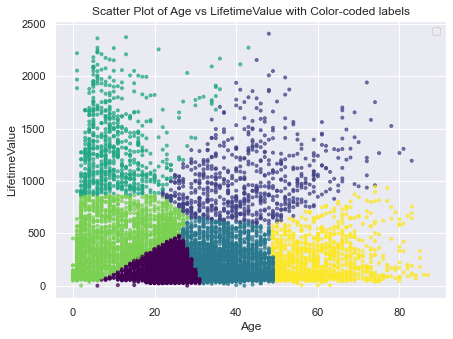

In [141]:
plt.figure(figsize=(7,5))
scatter = plt.scatter(data_preprocessed['Age'], data_preprocessed['LifetimeValue'], c=df_concat_dem_km['labels'], cmap='viridis',
                      alpha=0.7, marker='.')

# labelsing axes and title
plt.legend()
plt.xlabel('Age')
plt.ylabel('LifetimeValue')
plt.title('Scatter Plot of Age vs LifetimeValue with Color-coded labels')

plt.show()

<hr>
<a class="anchor" id="prod_bhv">

## 8.2. Product Behavorial Segmentation
    
</a>

In [142]:
r2_scores_prod_bhv = {}
r2_scores_prod_bhv['kmeans'] = get_r2_scores(df_prod_bhv, kmeans.set_params(n_init=10))

#for linkage in ['complete', 'average', 'single', 'ward']:
#    r2_scores_prod_bhv[linkage] = get_r2_scores(df_prod_bhv, hierarchical.set_params(linkage=linkage))

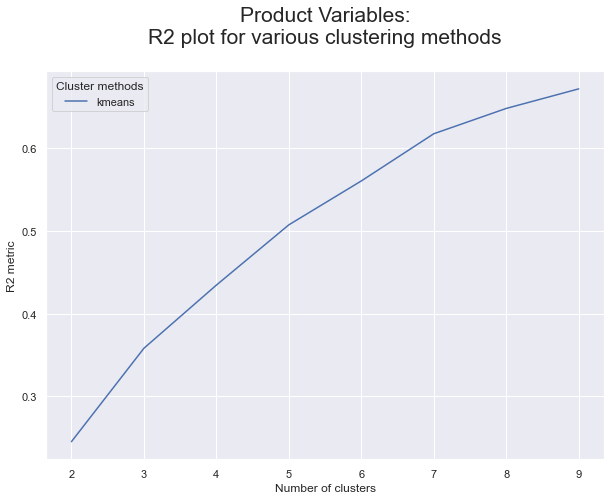

In [143]:
# Visualizing the R² scores for each cluster solution on product variables
pd.DataFrame(r2_scores_prod_bhv).plot.line(figsize=(10,7))

plt.title("Product Variables:\nR2 plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods")
plt.xlabel("Number of clusters")
plt.ylabel("R2 metric")
plt.show()

In [144]:
np.random.seed(42)

kmeans_prod_bhv = KMeans(n_clusters=7, init='k-means++', n_init=20, random_state=42)
km_labels_prod_bhv = kmeans_prod_bhv.fit_predict(df_prod_bhv)

df_concat_prod_bhv_km = pd.concat((df_prod_bhv, pd.Series(km_labels_prod_bhv, name='labels', index=df_prod_bhv.index)), axis=1)
pd.concat((data_preprocessed[product_behavioral_features], pd.Series(km_labels_prod_bhv, name='labels', index=df_prod_bhv.index)), axis=1).groupby('labels').mean()

,AttendedClasses,DaysWithoutFrequency,NumberOfFrequencies,NumberOfRenewals,EnrollmentTime,TotalActivities,RealNumberOfVisits,EnrolledMonthlyVisits,StillEnrolled
labels,,,,,,,,,
0,2.969451,22.913604,46.602864,0.431026,202.563246,1.007637,13.168974,7.548362,0.127924
1,15.653119,59.330340,56.304820,2.711720,873.803875,0.998582,4.589319,2.129823,0.313800
2,7.614573,67.242570,43.580058,1.866731,637.972196,2.093001,4.220518,2.442044,0.211889
3,2.924433,24.901763,286.707809,3.418136,1210.644836,1.274559,16.770781,7.590567,0.534005
4,2.702768,81.724405,13.468875,0.544784,213.329989,0.996857,2.978001,2.083188,0.063822
5,108.067657,34.623762,122.876238,3.665017,1249.585809,1.117162,6.100660,3.273293,0.640264
6,6.442029,820.586957,27.847826,3.210145,1123.405797,1.137681,3.014493,0.684043,0.293478


In [145]:
Counter(km_labels_prod_bhv)

Counter({4: 8273, 1: 2116, 0: 2095, 2: 1043, 5: 606, 3: 397, 6: 276})

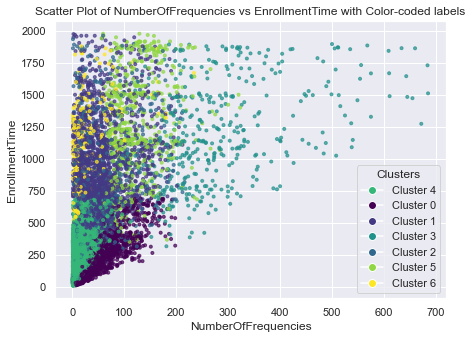

In [146]:
unique_labels = df_concat_prod_bhv_km['labels'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_labels)))

plt.figure(figsize=(7, 5))
scatter = plt.scatter(
            data_preprocessed['NumberOfFrequencies'], data_preprocessed['EnrollmentTime'],
            c=df_concat_prod_bhv_km['labels'], cmap='viridis', alpha=0.7, marker='.'
)

        # Creating a legend based on unique labels and their colors
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=f'Cluster {label}', 
                                    markerfacecolor=colors[label], markersize=8) for label in unique_labels]
plt.legend(handles=legend_elements, title='Clusters')

        # Labeling axes and title
plt.xlabel('NumberOfFrequencies')
plt.ylabel('EnrollmentTime')
plt.title(f"Scatter Plot of NumberOfFrequencies vs EnrollmentTime with Color-coded labels")

plt.show()

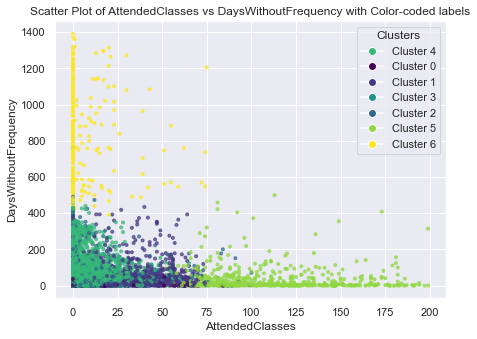

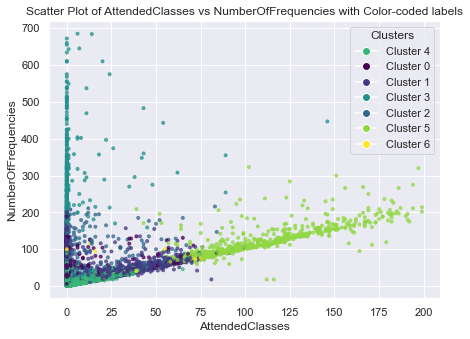

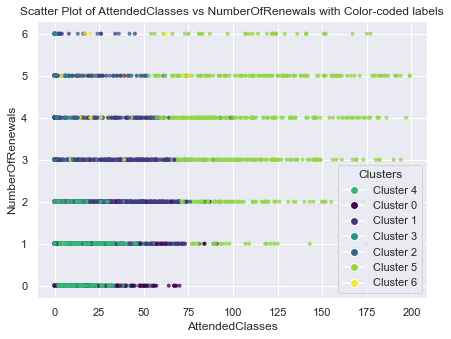

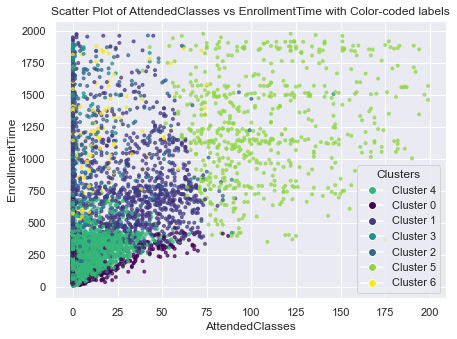

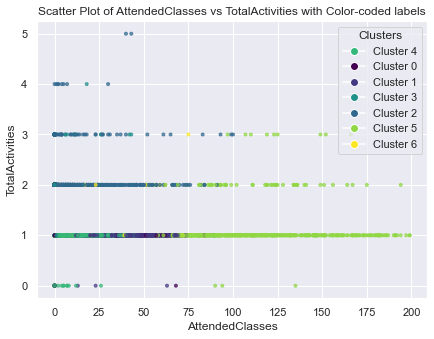

...

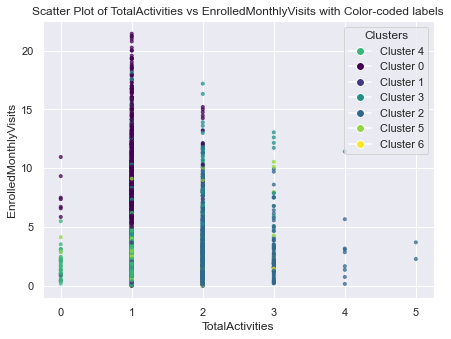

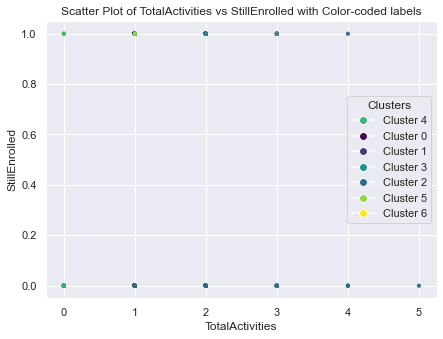

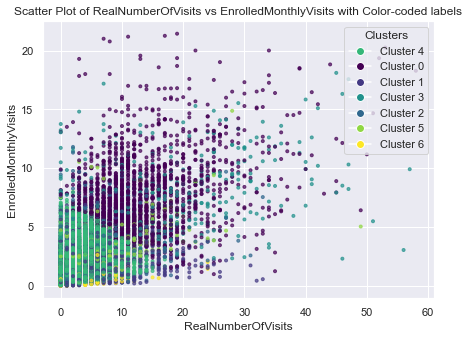

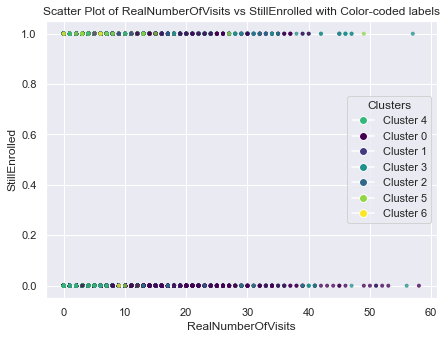

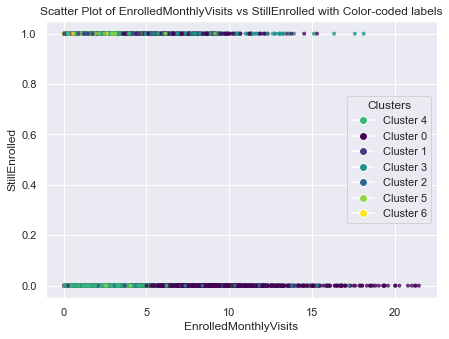

In [147]:
# Getting unique labels and their corresponding colors
unique_labels = df_concat_prod_bhv_km['labels'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_labels)))

for i in range(len(product_behavioral_features)):
    for j in range(i + 1, len(product_behavioral_features)):
        plt.figure(figsize=(7, 5))
        scatter = plt.scatter(
            data_preprocessed[product_behavioral_features[i]], data_preprocessed[product_behavioral_features[j]],
            c=df_concat_prod_bhv_km['labels'], cmap='viridis', alpha=0.7, marker='.'
        )

        # Creating a legend based on unique labels and their colors
        legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=f'Cluster {label}', 
                                       markerfacecolor=colors[label], markersize=8) for label in unique_labels]
        plt.legend(handles=legend_elements, title='Clusters')

        # Labeling axes and title
        plt.xlabel(product_behavioral_features[i])
        plt.ylabel(product_behavioral_features[j])
        plt.title(f"Scatter Plot of {product_behavioral_features[i]} vs {product_behavioral_features[j]} with Color-coded labels")

        plt.show()

Parameters: 3 None False 25 0.05 0.01 2 0.4 1


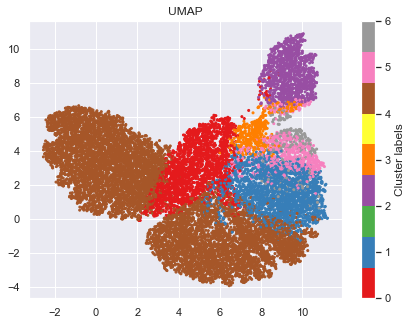

In [148]:
features = df_concat_prod_bhv_km[product_behavioral_features + ['labels']].drop(columns=['labels'])

n_comp = [2] # < 10
repulsion = [0.4]
dist = [1] #between 0 and 1
lr = [0.01]
target_weight = [0.05]
neighb = [25]
force_approx = [False]
n_epochs=[None]
spread=[3]

plot_umap(features.values, df_concat_prod_bhv_km[product_behavioral_features + ['labels']], 'labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

<hr>
<a class="anchor" id="merge">

## 8.3. Merging Perspectives
    
</a>

In [149]:
np.random.seed(42)

data['demographic_labels'] = km_labels_dem
data['product_behavioral_labels'] = km_labels_prod_bhv

data_preprocessed['demographic_labels'] = km_labels_dem
data_preprocessed['product_behavioral_labels'] = km_labels_prod_bhv

In [150]:
pd.crosstab(data['demographic_labels'],
            data['product_behavioral_labels'])

product_behavioral_labels,0,1,2,3,4,5,6
demographic_labels,,,,,,,
0,1348,607,453,12,5206,0,123
1,10,210,116,210,12,108,13
2,433,314,206,19,1429,20,43
3,1,178,50,46,2,408,18
4,95,663,155,71,1131,62,61
5,208,144,63,39,493,8,18


In [151]:
df_centroids = data.groupby(['demographic_labels','product_behavioral_labels']).mean()
df_centroids

Age  DaysWithoutFrequency  \
demographic_labels product_behavioral_labels                                   
0                  0                         -0.229923             -0.404928   
                   1                         -0.215889             -0.179008   
                   2                         -0.211535             -0.096868   
                   3                         -0.169917             -0.442156   
                   4                         -0.275666              0.034958   
                   6                         -0.159987              5.862181   
1                  0                          1.148315             -0.519372   
                   1                          1.180685             -0.086890   
                   2                          1.153687             -0.108704   
                   3                          1.142246             -0.388176   
                   4                          0.927626             -0.023071   
                   5                          1.250202             -0.280389   
                   6                          1.068791              4.564832   
2                  0                          0.823279             -0.424162   
                   1                          0.739065             -0.104075   
                   2                          0.724766             -0.075300   
                   3                          0.616128             -0.441500   
                   4                          0.833771              0.023687   
                   5                          0.691595             -0.339284   
                   6                          0.727412              5.852276   
3                  0                         -0.777697             -0.586625   
                   1                         -1.243924             -0.217532   
                   2                         -0.806020             -0.219424   
                   3                         -0.088076             -0.430514   
                   4                         -0.848506              0.892939   
                   5                         -1.208973             -0.344811   
                   6                         -0.793432              4.953852   
4                  0                         -0.905899             -0.494280   
                   1                         -0.939821             -0.204207   
                   2                         -0.621003             -0.100765   
                   3                         -0.227180             -0.426228   
                   4                         -1.320880             -0.085363   
                   5                         -0.755997             -0.354856   
                   6                         -0.790465              5.222360   
5                  0                          2.488039             -0.498463   
                   1                          2.504607              0.102146   
                   2                          2.449182              0.048067   
                   3                          2.891675             -0.428360   
                   4                          2.414608              0.033384   
                   5                          2.444124             -0.435306   
                   6                          2.526735              4.925207   

                                              LifetimeValue  UseByTime  \
demographic_labels product_behavioral_labels                             
0                  0                              -0.458071   0.028190   
                   1                              -0.177518   0.153213   
                   2                              -0.324721   0.057395   
                   3                               0.245948   0.166667   
                   4                              -0.542033   0.031694   
                   6                              -0.390832   0.000000   
1                 

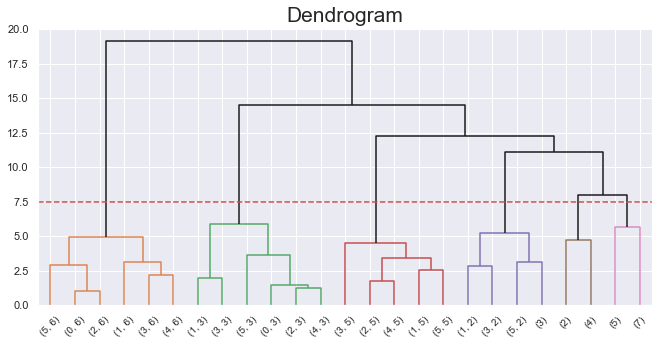

In [152]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
hclust = AgglomerativeClustering(linkage='ward', metric='euclidean', distance_threshold=0, n_clusters=None)
hclust_labels = hclust.fit_predict(df_centroids)

# create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

linkage_matrix = np.column_stack([hclust.children_, hclust.distances_, counts]).astype(float)

# Plot the corresponding dendrogram
sns.set()
fig = plt.figure(figsize=(11,5))
# The Dendrogram parameters need to be tuned
y_threshold = 7.5
dendrogram(linkage_matrix, 
           truncate_mode='level', labels=df_centroids.index, p=5, 
           color_threshold=y_threshold, above_threshold_color='k')

plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")
plt.title(f'Dendrogram', fontsize=21)
plt.show()

In [153]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(linkage='ward', metric='euclidean', n_clusters=6)
hclust_labels = hclust.fit_predict(df_centroids)
df_centroids['hclust_labels'] = hclust_labels

df_centroids['hclust_labels'].to_dict()  

{(0, 0): 5,
 (0, 1): 2,
 (0, 2): 1,
 (0, 3): 0,
 (0, 4): 2,
 (0, 6): 4,
 (1, 0): 5,
 (1, 1): 2,
 (1, 2): 1,
 (1, 3): 0,
 (1, 4): 2,
 (1, 5): 3,
 (1, 6): 4,
 (2, 0): 5,
 (2, 1): 2,
 (2, 2): 1,
 (2, 3): 0,
 (2, 4): 2,
 (2, 5): 3,
 (2, 6): 4,
 (3, 0): 5,
 (3, 1): 2,
 (3, 2): 1,
 (3, 3): 0,
 (3, 4): 2,
 (3, 5): 3,
 (3, 6): 4,
 (4, 0): 5,
 (4, 1): 2,
 (4, 2): 1,
 (4, 3): 0,
 (4, 4): 2,
 (4, 5): 3,
 (4, 6): 4,
 (5, 0): 5,
 (5, 1): 2,
 (5, 2): 1,
 (5, 3): 0,
 (5, 4): 2,
 (5, 5): 3,
 (5, 6): 4}

In [154]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

data_ = data.copy()

# Mapping the hierarchical clusters on the centroids to the observations
data_['merged_labels'] = data_.apply(
    lambda row: cluster_mapper[(row['demographic_labels'], row['product_behavioral_labels'])], axis=1
)

# Merged cluster centroids
data_.groupby('merged_labels').mean()[metric_features]

,Age,DaysWithoutFrequency,LifetimeValue,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,TotalActivities,EnrollmentTime,EnrolledMonthlyVisits
merged_labels,,,,,,,,,,,,
0,0.861796,-0.408018,1.963759,4.230054,-0.257509,0.678843,1.904736,1.641144,0.036940,0.564395,1.863543,1.656739
1,0.196593,-0.091624,0.323737,0.087031,-0.068828,0.053687,-0.167708,0.500528,0.014282,3.078714,0.509938,-0.225450
2,-0.064744,-0.017492,-0.206596,-0.277406,-0.160314,-0.033127,-0.318692,-0.146895,-0.034732,-0.287648,-0.175805,-0.353167
3,-0.613410,-0.335370,2.782814,1.438279,3.972325,-0.898709,0.142763,1.822654,0.869123,0.080858,1.955587,0.078437
4,0.030709,5.537775,0.268588,-0.181055,-0.115999,-0.071493,-0.366861,1.488226,0.022724,0.143895,1.657340,-0.868137
5,0.233270,-0.422875,-0.349148,0.138541,-0.255698,0.278286,1.309964,-0.555022,-0.096273,-0.255610,-0.519221,1.641310


In [155]:
#Merge cluster contigency table
# Getting size of each final cluster
df_counts = data_.groupby('merged_labels').size().to_frame()

# Getting the product and behavior labels
df_counts = df_counts.rename({v:k for k, v in cluster_mapper.items()}).reset_index()

df_counts['demographic_labels'] = df_counts['merged_labels'].apply(lambda x: x[0])
df_counts['product_behavioral_labels'] = df_counts['merged_labels'].apply(lambda x: x[1])

df_counts.pivot(values=0, index='demographic_labels', columns='product_behavioral_labels')

product_behavioral_labels,0,2,3,4,5,6
demographic_labels,,,,,,
5,2095,1043,397,10389,606,276


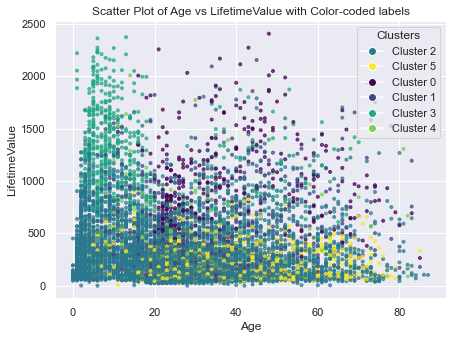

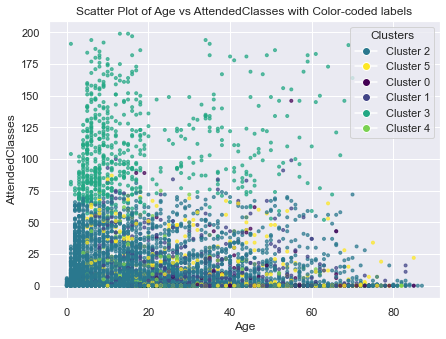

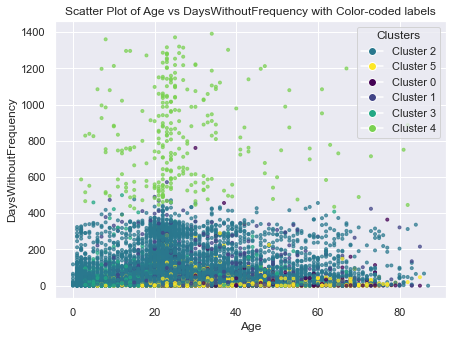

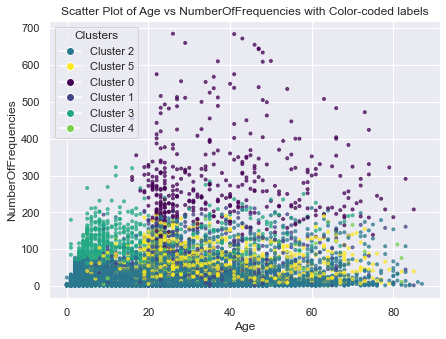

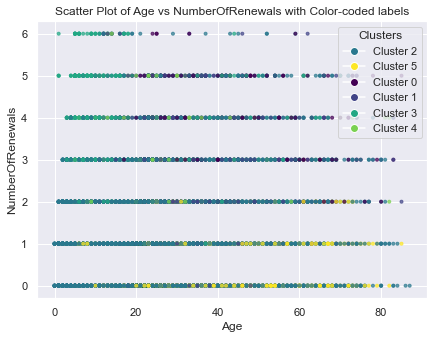

...

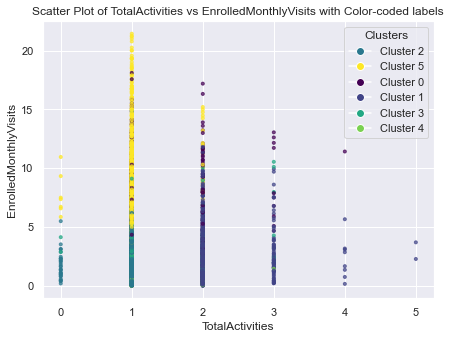

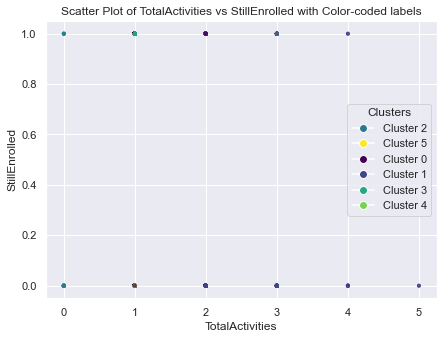

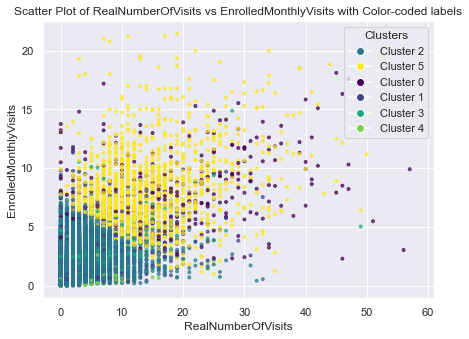

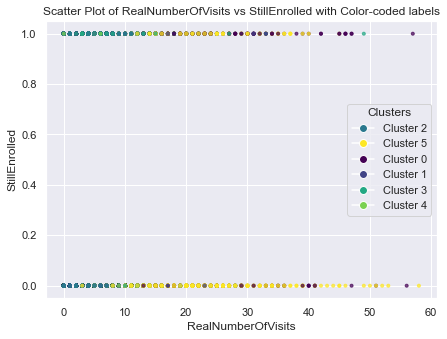

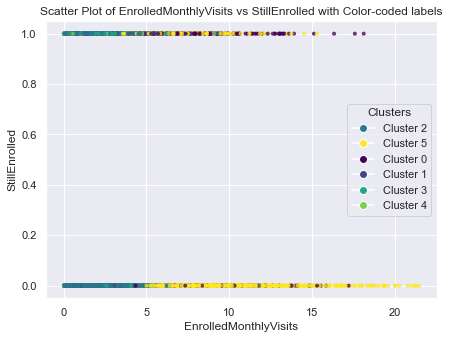

In [156]:
# Getting unique labels and their corresponding colors
unique_labels = data_['merged_labels'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(unique_labels)))

feats = demographic_features+product_behavioral_features

for i in range(len(feats)):
    for j in range(i + 1, len(feats)):
        plt.figure(figsize=(7, 5))
        scatter = plt.scatter(
            data_preprocessed[feats[i]], data_preprocessed[feats[j]],
            c=data_['merged_labels'], cmap='viridis', alpha=0.7, marker='.'
        )

        # Creating a legend based on unique labels and their colors
        legend_elements = [plt.Line2D([0], [0], marker='o', color='w', label=f'Cluster {label}', 
                                       markerfacecolor=colors[label], markersize=8) for label in unique_labels]
        plt.legend(handles=legend_elements, title='Clusters')

        # Labeling axes and title
        plt.xlabel(feats[i])
        plt.ylabel(feats[j])
        plt.title(f"Scatter Plot of {feats[i]} vs {feats[j]} with Color-coded labels")

        plt.show()

Parameters: 2 None True 100 0.25 0.1 4 2 1


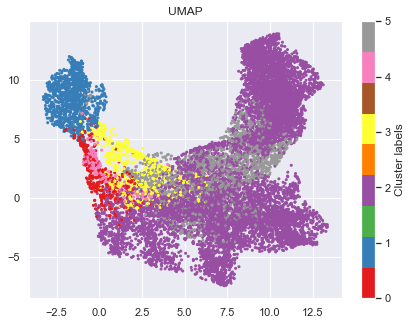

In [157]:
data_select = data_[['merged_labels'] + product_behavioral_features + demographic_features].copy()
features = data_select.drop(columns=['merged_labels'])

n_comp = [4] # < 10
repulsion = [2]
dist = [1] #between 0 and 1
lr = [0.1]
target_weight = [0.25]
neighb = [100]
force_approx = [True]
n_epochs=[None]
spread=[2]

plot_umap(features, data_select, 'merged_labels', spread, n_epochs, force_approx, neighb, target_weight, lr, n_comp, repulsion, dist)

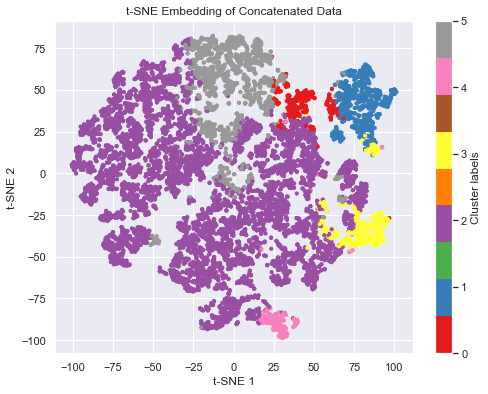

In [158]:
plot_tsne(features, data_select, 'merged_labels')

<hr>
<a class="anchor" id="prof">

## 8.4. Profiling
    
</a>

In [159]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = df_centroids['hclust_labels'].to_dict()

# Mapping the hierarchical clusters on the centroids to the observations
data_preprocessed['merged_labels'] = data_preprocessed.apply(
    lambda row: cluster_mapper[(row['demographic_labels'], row['product_behavioral_labels'])], axis=1
)

# Merged cluster centroids
data_preprocessed.groupby('merged_labels').mean()

,Age,DaysWithoutFrequency,LifetimeValue,UseByTime,WaterActivities,FitnessActivities,TeamActivities,CombatActivities,SpecialActivities,NumberOfFrequencies,AttendedClasses,AllowedNumberOfVisitsBySLA,RealNumberOfVisits,NumberOfRenewals,NumberOfReferences,Gender_Male,EnrollmentTime,StillEnrolled,EnrolledMonthlyVisits,TotalActivities,demographic_labels,product_behavioral_labels
merged_labels,,,,,,,,,,,,,,,,,,,,,,
0,38.153652,24.901763,964.084282,0.133501,0.302267,0.682620,0.037783,0.088161,0.151134,286.707809,2.924433,54.670025,16.770781,3.418136,0.027708,0.566751,1210.644836,0.534005,7.590567,1.274559,2.178841,3.000000
1,28.759348,67.242570,405.415369,0.081496,0.525407,0.778523,0.147651,0.401726,0.143816,43.580058,7.614573,42.393097,4.220518,1.866731,0.023969,0.455417,637.972196,0.211889,2.442044,2.093001,1.546500,2.000000
2,25.068630,77.163250,224.758902,0.045721,0.261238,0.545481,0.051497,0.099721,0.009337,22.193570,5.340456,40.688228,3.306189,0.986139,0.015882,0.379440,347.853306,0.114737,2.092687,0.997209,1.406199,3.388969
3,17.320132,34.623762,1243.093053,0.009901,0.861386,0.102310,0.085809,0.023102,0.019802,122.876238,108.067657,23.689769,6.100660,3.665017,0.165017,0.410891,1249.585809,0.640264,3.273293,1.117162,2.739274,5.000000
4,26.416667,820.586957,386.628986,0.000000,0.235507,0.557971,0.159420,0.115942,0.018116,27.847826,6.442029,39.934783,3.014493,3.210145,0.025362,0.452899,1123.405797,0.293478,0.684043,1.137681,1.764493,6.000000
5,29.277327,22.913604,176.198897,0.036277,0.173270,0.755131,0.008115,0.025776,0.028162,46.602864,2.969451,46.803819,13.168974,0.431026,0.005728,0.442482,202.563246,0.127924,7.548362,1.007637,1.097375,0.000000


### Using the R²
What proportion of each variables total SS is explained between clusters?

In [160]:
def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

In [161]:
r2_variables(data_preprocessed, 'merged_labels').drop('merged_labels')

c:\ProgramData\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


Age                           0.048696
DaysWithoutFrequency          0.606842
LifetimeValue                 0.476287
UseByTime                     0.008927
WaterActivities               0.095796
FitnessActivities             0.072028
TeamActivities                0.022526
CombatActivities              0.077081
SpecialActivities             0.063331
NumberOfFrequencies           0.622308
AttendedClasses               0.675486
AllowedNumberOfVisitsBySLA    0.057440
RealNumberOfVisits            0.416679
NumberOfRenewals              0.325852
NumberOfReferences            0.033135
Gender_Male                   0.006530
EnrollmentTime                0.378999
StillEnrolled                 0.114080
EnrolledMonthlyVisits         0.560174
TotalActivities               0.744203
demographic_labels            0.033612
product_behavioral_labels     0.634027
dtype: float64

In [162]:
# Preparing the data
X = data_.drop(columns=['demographic_labels','product_behavioral_labels','merged_labels'])
y = data_.merged_labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=7)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 96.89% of the customers correctly


In [163]:
pd.Series(dt.feature_importances_, index=X_train.columns).sort_values(ascending = False)

EnrolledMonthlyVisits         0.337507
TotalActivities               0.254895
AttendedClasses               0.141434
RealNumberOfVisits            0.088663
DaysWithoutFrequency          0.078531
NumberOfFrequencies           0.077385
EnrollmentTime                0.016361
LifetimeValue                 0.002312
NumberOfRenewals              0.001107
Age                           0.000714
SpecialActivities             0.000321
AllowedNumberOfVisitsBySLA    0.000315
TeamActivities                0.000263
Gender_Male                   0.000193
WaterActivities               0.000000
CombatActivities              0.000000
NumberOfReferences            0.000000
StillEnrolled                 0.000000
FitnessActivities             0.000000
UseByTime                     0.000000
dtype: float64

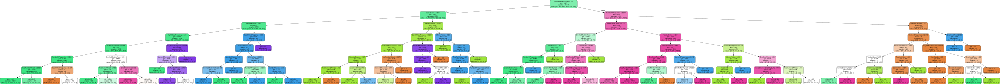

In [164]:
# Assuming 'dt' is your trained DecisionTreeClassifier and 'X' contains your features
dot_data = export_graphviz(dt, out_file=None, 
                           feature_names=X.columns.to_list(),
                           filled=True,
                           rounded=True,
                           special_characters=True)
graph = graphviz.Source(dot_data)
graph